In [1]:
# Import necessary libraries
import numpy as np
import pandas as pd
import scipy.io
import matplotlib.pyplot as plt
import warnings
from collections import defaultdict, Counter
import tensorflow as tf
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.mixture import GaussianMixture
from sklearn.manifold import TSNE
from sklearn.metrics import pairwise_distances
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Suppress warnings for cleaner outputs
warnings.filterwarnings("ignore")

In [2]:
# Load the UMist dataset
umist_faces_data = scipy.io.loadmat("umist_cropped.mat")
images = umist_faces_data.get("facedat")

# Flatten images and assign labels
labels = np.array([i for i, faces in enumerate(images[0]) for _ in range(faces.shape[-1])])
reshaped_images = [images[0][i][:, :, j].flatten() for i in range(len(images[0])) for j in range(images[0][i].shape[-1])]
X = np.array(reshaped_images) / 255.0  # Normalize images
y = labels  # Assign labels

In [3]:
# Convert to a pandas DataFrame
df = pd.DataFrame(X)
df['label'] = y
print(df.head())

          0         1         2         3         4         5         6  \
0  0.913725  0.917647  0.917647  0.913725  0.917647  0.909804  0.909804   
1  0.917647  0.917647  0.917647  0.917647  0.913725  0.909804  0.792157   
2  0.917647  0.917647  0.917647  0.917647  0.913725  0.901961  0.882353   
3  0.917647  0.917647  0.917647  0.917647  0.917647  0.917647  0.917647   
4  0.917647  0.917647  0.917647  0.917647  0.917647  0.917647  0.917647   

          7         8         9  ...     10295     10296     10297     10298  \
0  0.658824  0.388235  0.305882  ...  0.603922  0.592157  0.576471  0.560784   
1  0.384314  0.309804  0.301961  ...  0.603922  0.588235  0.576471  0.552941   
2  0.427451  0.333333  0.329412  ...  0.682353  0.658824  0.643137  0.615686   
3  0.909804  0.898039  0.803922  ...  0.658824  0.635294  0.615686  0.607843   
4  0.917647  0.898039  0.827451  ...  0.690196  0.666667  0.643137  0.635294   

      10299     10300     10301     10302     10303  label  
0  0.54

Number of duplicate groups: 10
Duplicate Group 1: Images [42, 63]


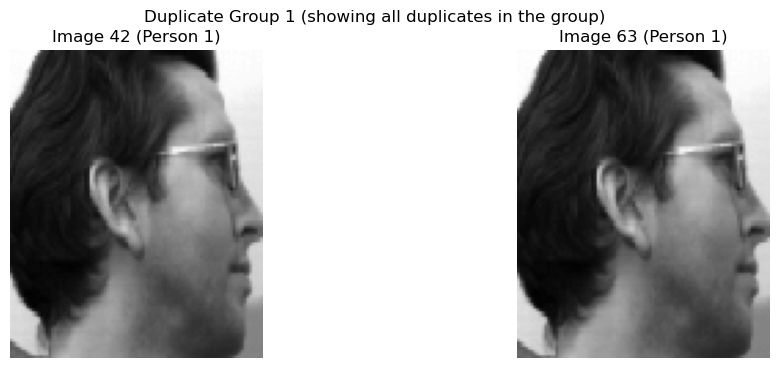

Duplicate Group 2: Images [44, 64]


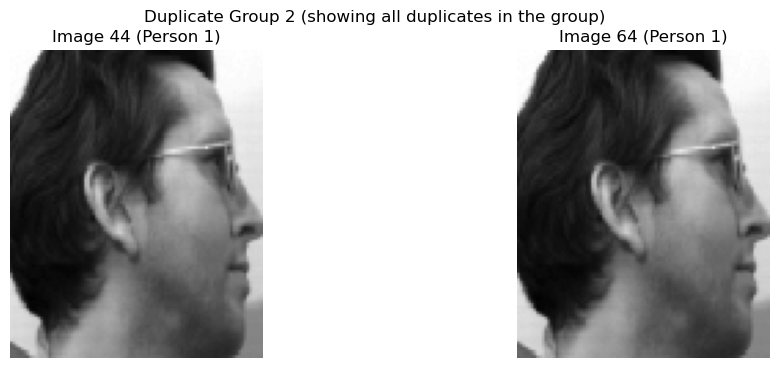

Duplicate Group 3: Images [46, 65]


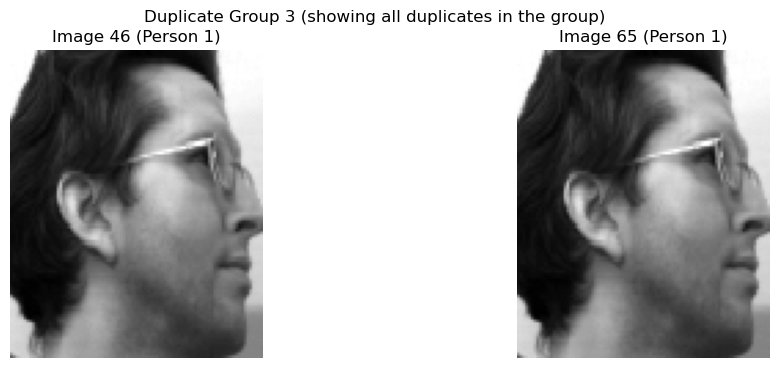

Duplicate Group 4: Images [48, 66]


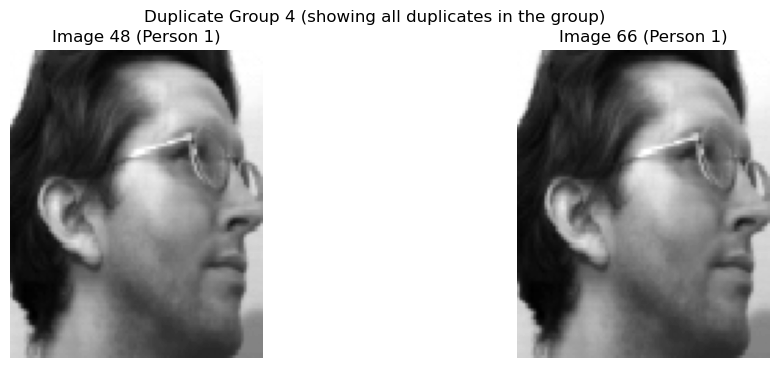

Duplicate Group 5: Images [50, 67]


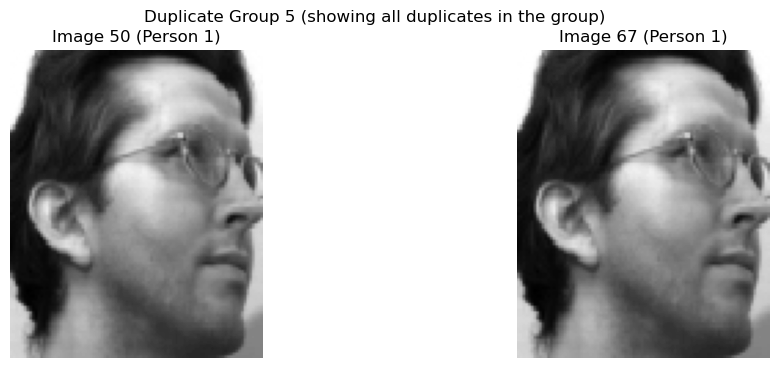

Duplicate Group 6: Images [52, 68]


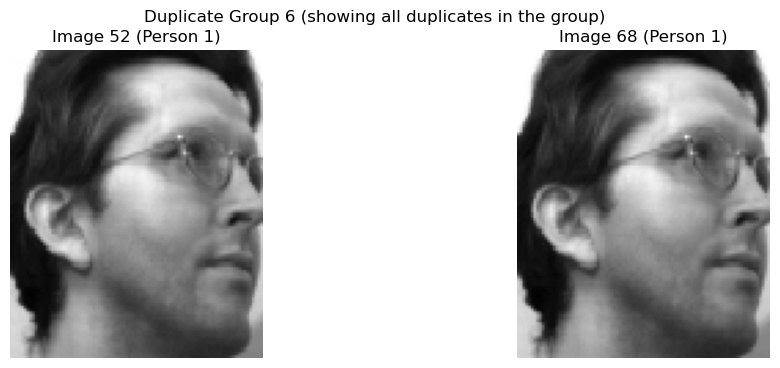

Duplicate Group 7: Images [54, 69]


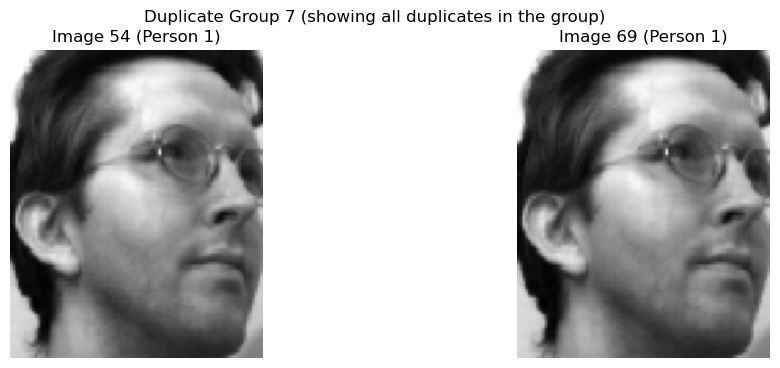

Duplicate Group 8: Images [57, 70]


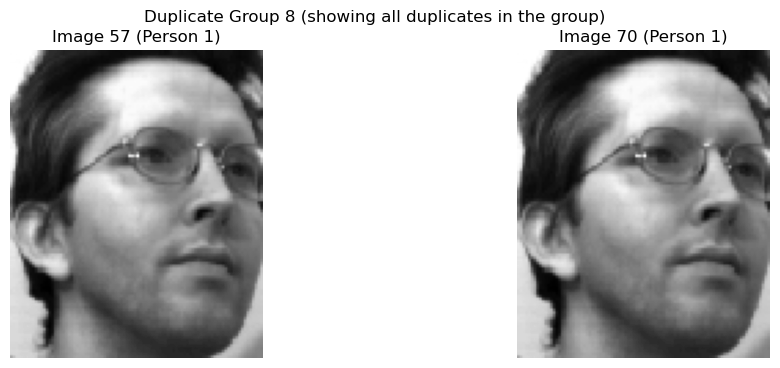

Duplicate Group 9: Images [59, 71]


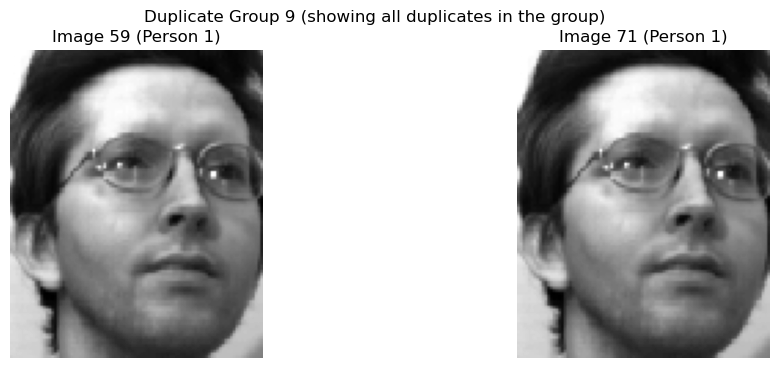

Duplicate Group 10: Images [61, 72]


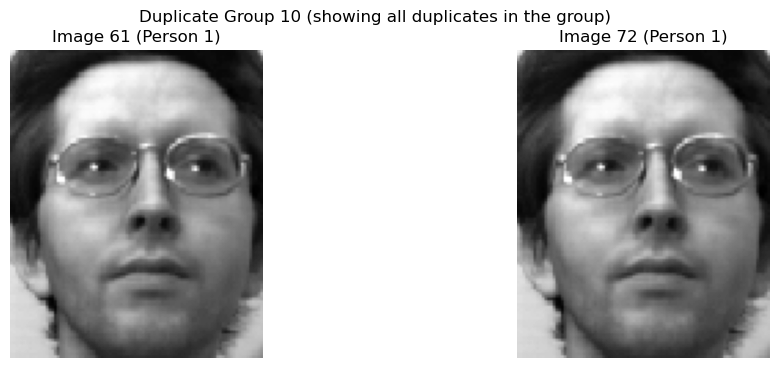

In [4]:

# Identify duplicates in the original DataFrame with pixel values (excluding the label column)
duplicates_df = df.duplicated(subset=df.columns[:-1], keep=False)  # Keep all duplicates to show pairs
duplicate_indices = df[duplicates_df].index  # Indices of all duplicate rows

# Group duplicates based on identical pixel values
duplicate_groups = defaultdict(list)
for idx in duplicate_indices:
    # Use the pixel values (excluding label) as a key for grouping
    pixel_values_tuple = tuple(df.drop(columns='label').iloc[idx].values)
    duplicate_groups[pixel_values_tuple].append(idx)

# Filter to only groups with actual duplicates
duplicate_groups = {k: v for k, v in duplicate_groups.items() if len(v) > 1}

# Print number of duplicate groups
print(f"Number of duplicate groups: {len(duplicate_groups)}")

# Visualize duplicate groups
for group_num, (pixel_values, indices) in enumerate(duplicate_groups.items(), start=1):
    print(f"Duplicate Group {group_num}: Images {indices}")
    
    plt.figure(figsize=(12, 4))
    for i, idx in enumerate(indices):
        img = df.drop(columns='label').iloc[idx].values.reshape(112, 92)  # Reshape to original image size
        plt.subplot(1, len(indices), i + 1)
        plt.imshow(img, cmap='gray')
        plt.title(f"Image {idx} (Person {df['label'].iloc[idx]})")
        plt.axis('off')
    plt.suptitle(f"Duplicate Group {group_num} (showing all duplicates in the group)")
    plt.show()

Duplicates have been removed from the original DataFrame.


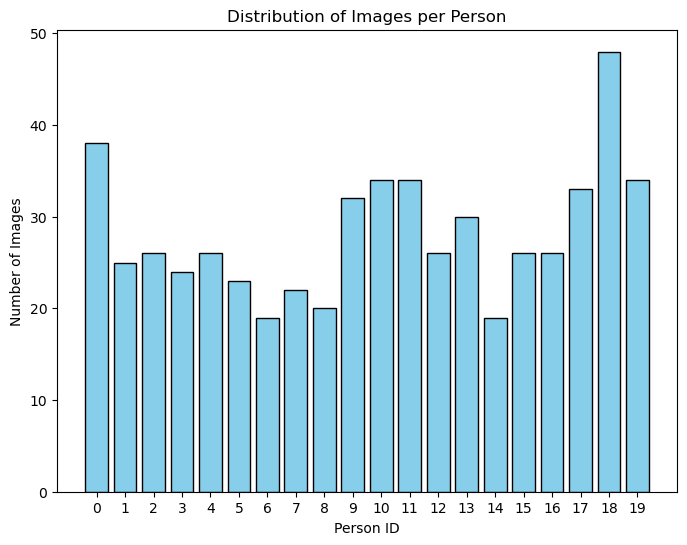

In [5]:
# Remove duplicates, keeping only the first occurrence
df = df.drop_duplicates(subset=df.columns[:-1], keep='first').reset_index(drop=True)
print("Duplicates have been removed from the original DataFrame.")

# Check the distribution of images per class (person)
unique_labels, counts = np.unique(df['label'], return_counts=True)

# Plot the histogram
plt.figure(figsize=(8, 6))
plt.bar(unique_labels, counts, color="skyblue", edgecolor="black")
plt.xlabel("Person ID")
plt.ylabel("Number of Images")
plt.title("Distribution of Images per Person")
plt.xticks(unique_labels)
plt.show()


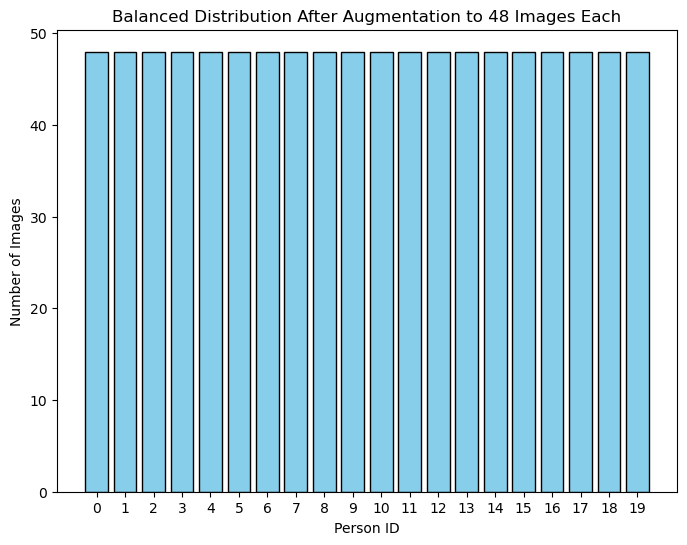

In [6]:
# Initialize the ImageDataGenerator for augmentation (last 4 images only)
datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    fill_mode="nearest"
)

# Target count per person
target_count = 48

# Augment only from the last 4 images for most subjects and middle images for subject 6
augmented_images = []
augmented_labels = []

for person_id in np.unique(y):
    person_images = df[df['label'] == person_id].drop(columns='label').values
    current_count = len(person_images)
    
    if current_count < target_count:
        if person_id == 6:  # Use middle images for subject 6
            mid_index = len(person_images) // 2
            mid_start = max(0, mid_index - 2)  # Select 4 images around the middle
            middle_images = person_images[mid_start:mid_start + 4]
            selected_images = middle_images
        else:  # Use last 4 images for others
            selected_images = person_images[-4:]
        
        while current_count < target_count:
            for img in selected_images:
                img = img.reshape(112, 92, 1)  # Add channel dimension
                img = np.expand_dims(img, 0)  # Add batch dimension
                
                for batch in datagen.flow(img, batch_size=1):
                    augmented_images.append(batch[0].reshape(-1))  # Flatten
                    augmented_labels.append(person_id)
                    current_count += 1
                    if current_count >= target_count:
                        break
                if current_count >= target_count:
                    break

# Combine augmented data
if augmented_images:
    augmented_df = pd.DataFrame(augmented_images)
    augmented_df['label'] = augmented_labels
    df = pd.concat([df, augmented_df], ignore_index=True)

# Check the distribution of images after augmentation
unique_labels, counts = np.unique(df['label'], return_counts=True)
plt.figure(figsize=(8, 6))
plt.bar(unique_labels, counts, color="skyblue", edgecolor="black")
plt.xlabel("Person ID")
plt.ylabel("Number of Images")
plt.title("Balanced Distribution After Augmentation to 48 Images Each")
plt.xticks(unique_labels)
plt.show()



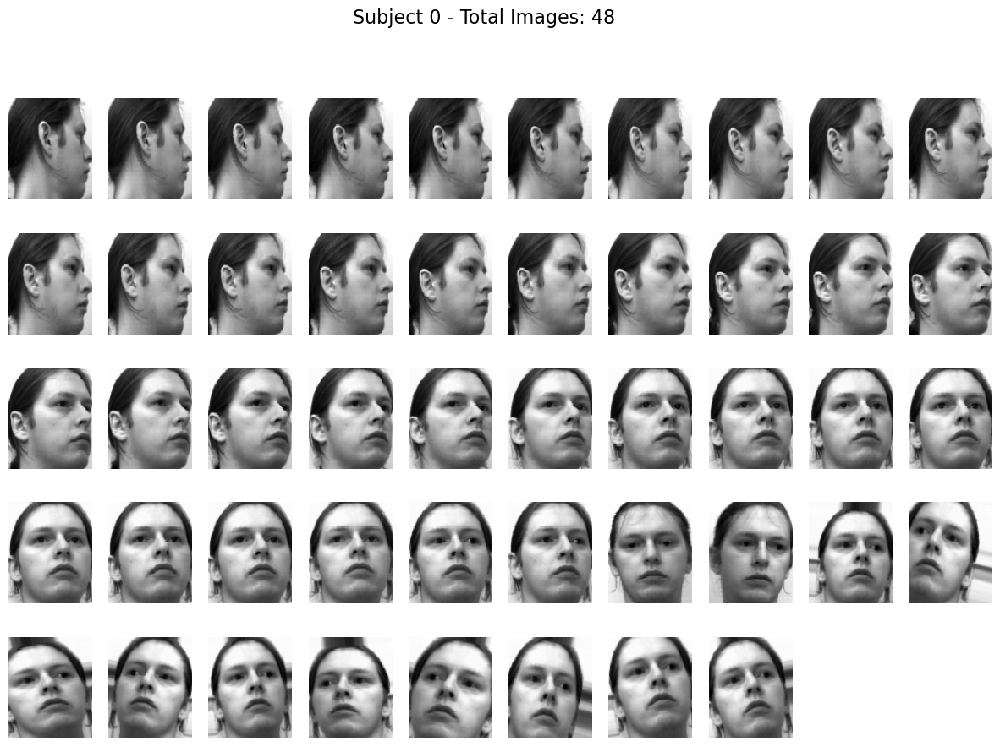

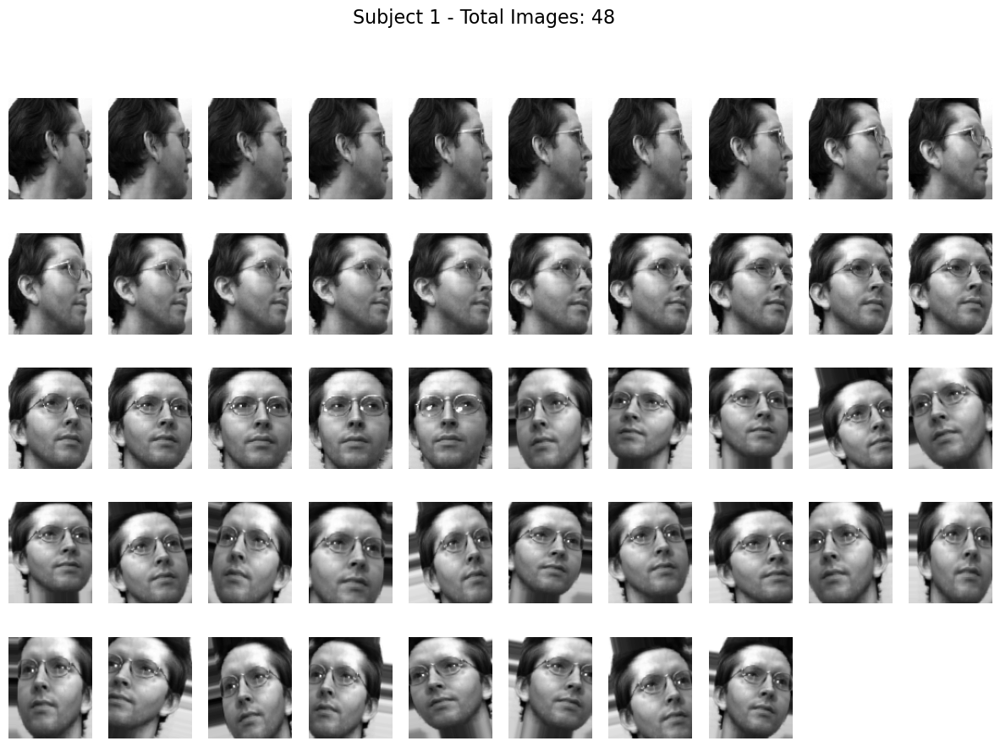

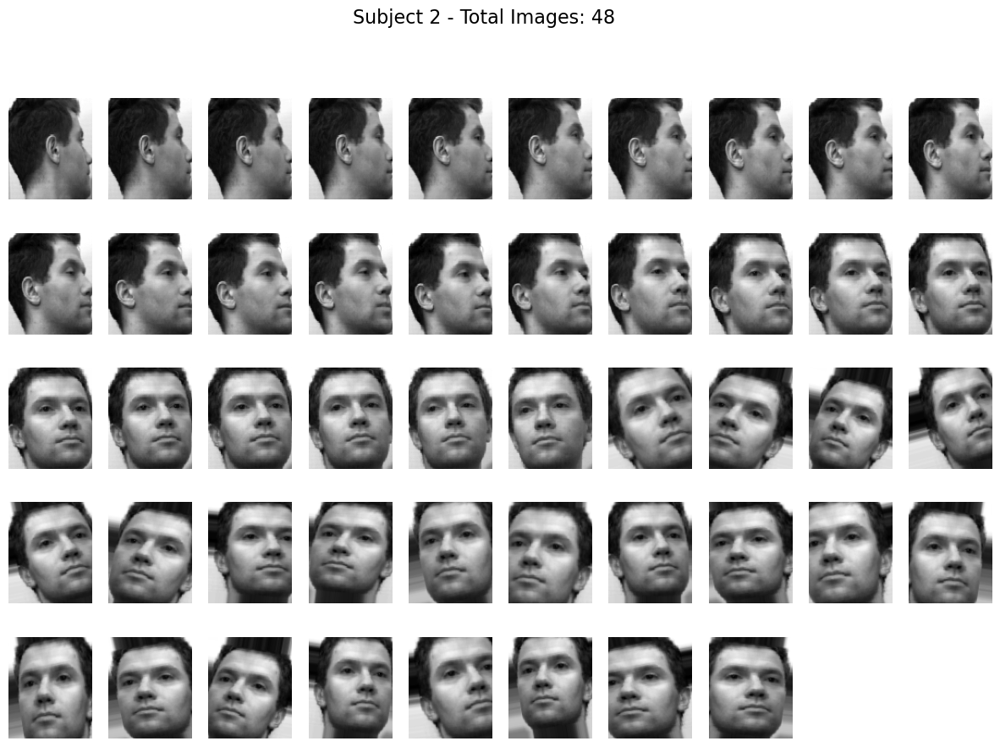

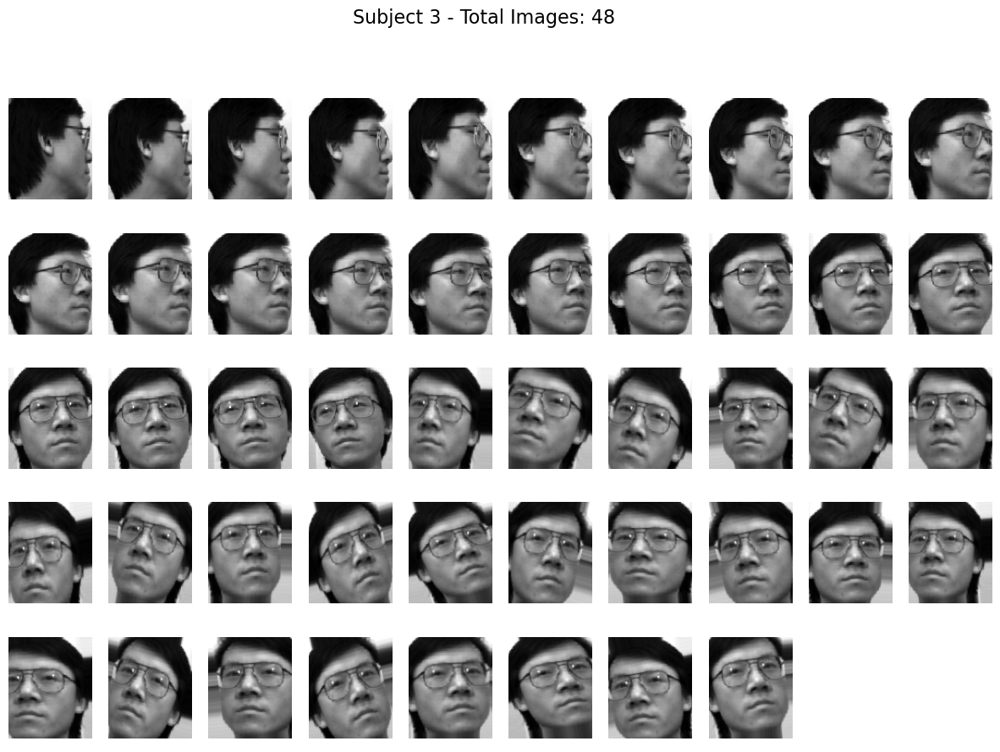

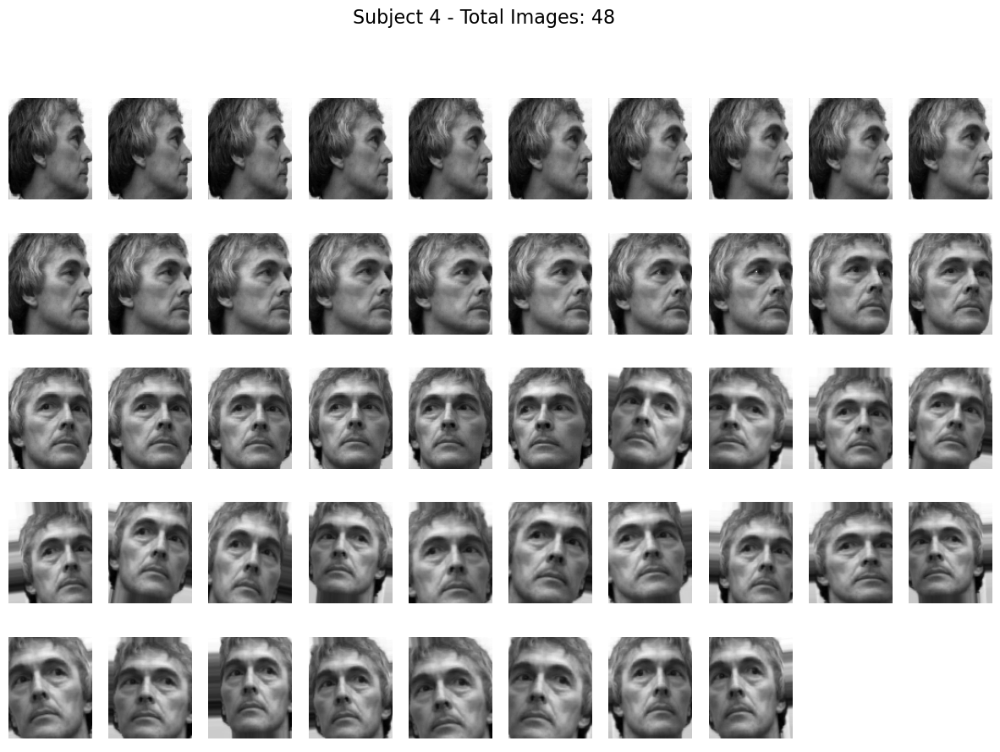

...

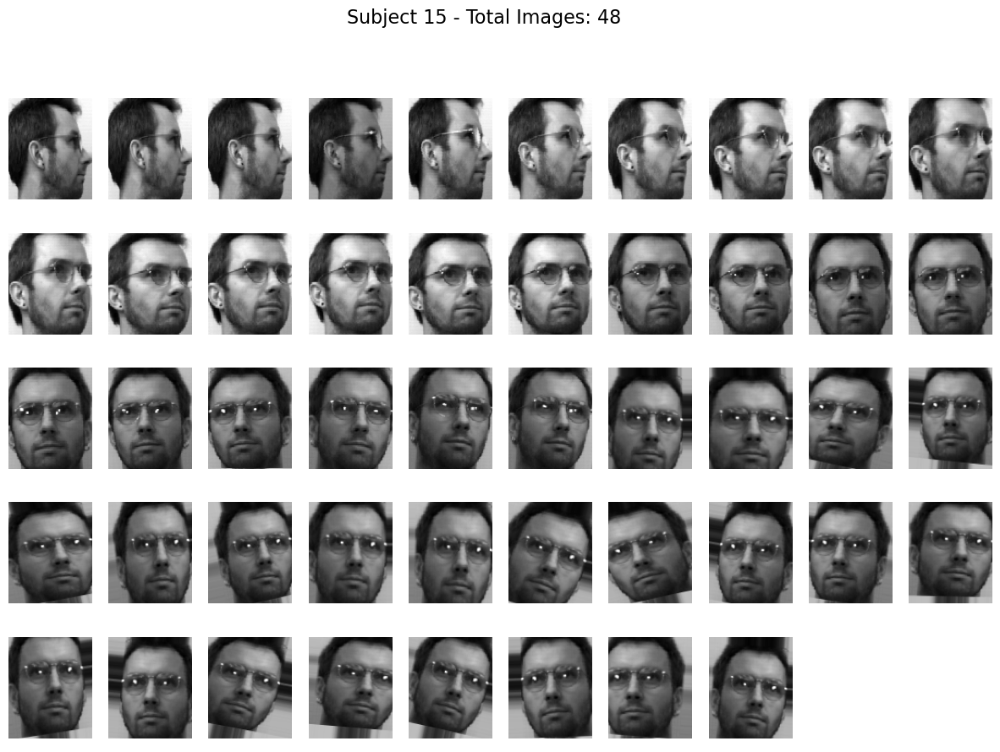

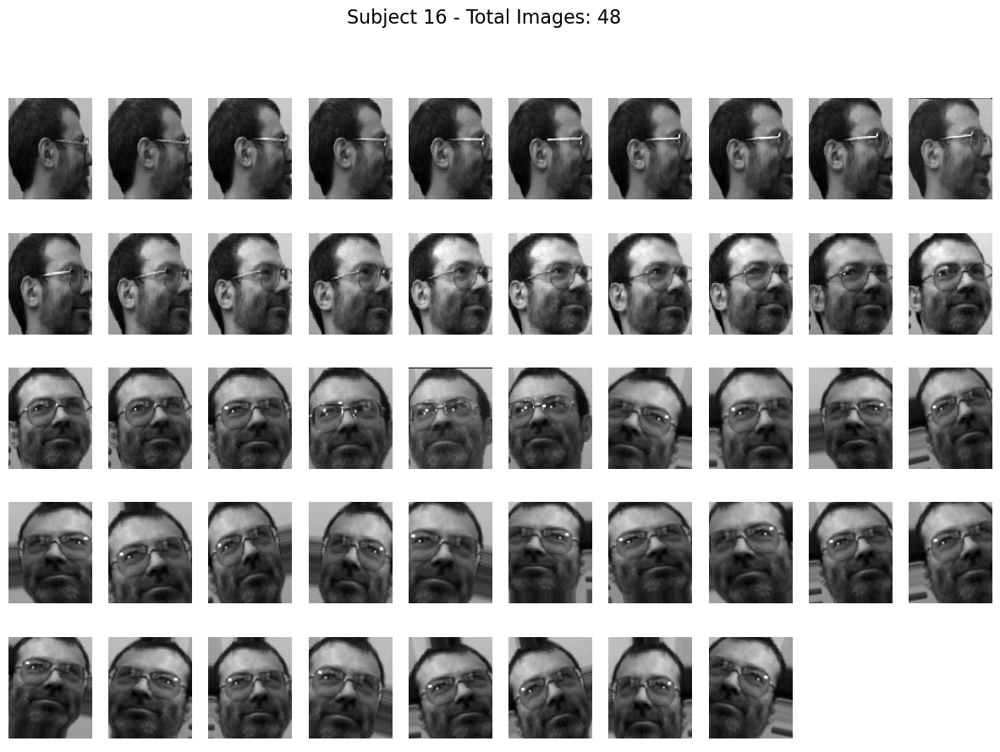

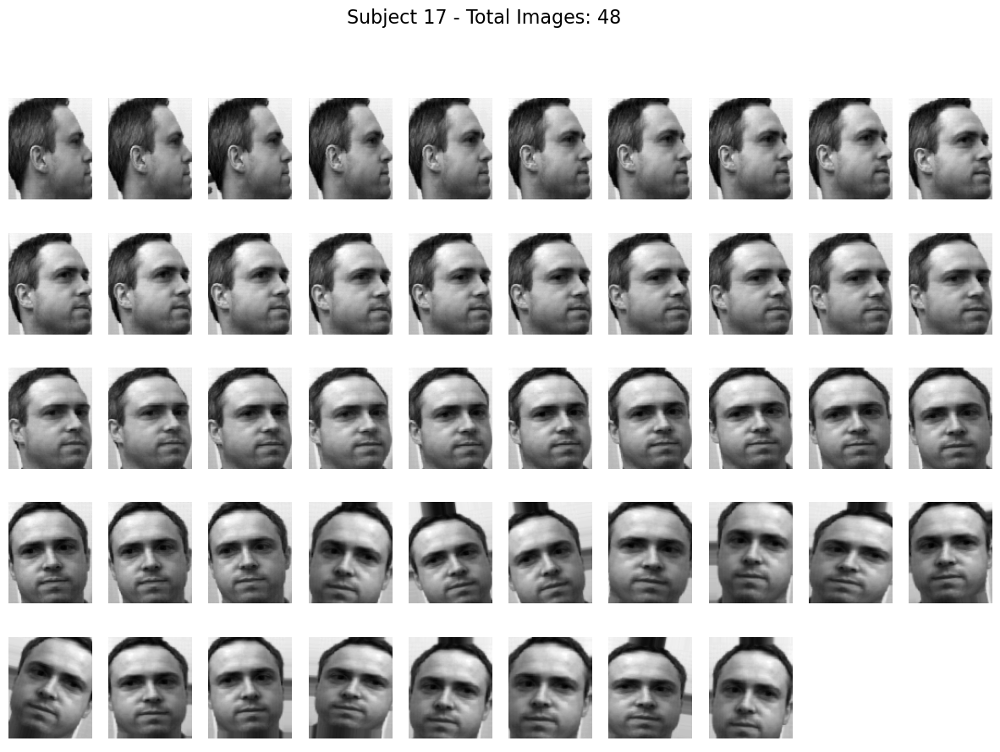

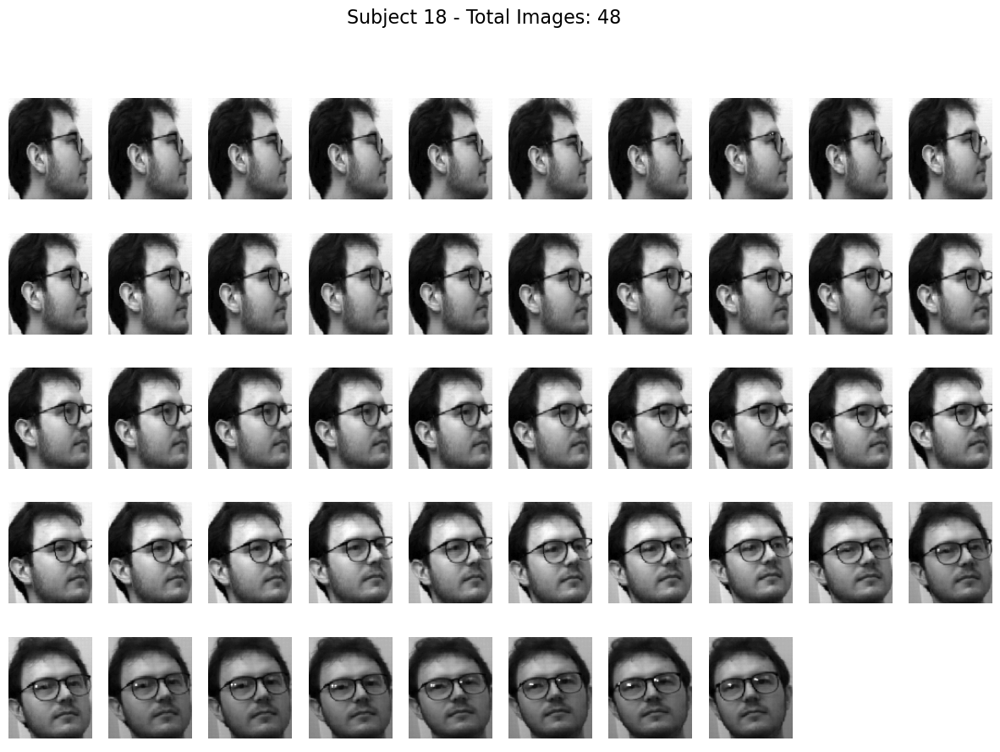

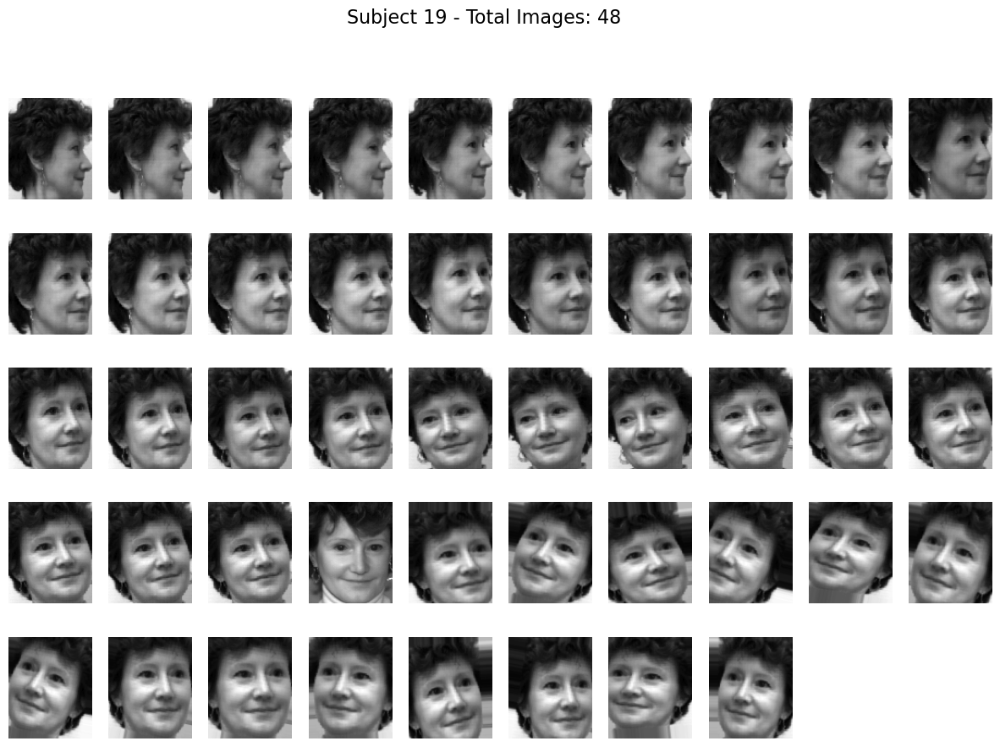

In [7]:
# Get the unique labels for each subject
unique_labels = sorted(df['label'].unique())

# Define the number of images to display per row for each subject
images_per_row = 10  # Adjust based on your preference and screen size

# Loop through each subject and display their images
for subject_id in unique_labels:
    subject_images = df[df['label'] == subject_id].drop(columns='label').values
    num_images = subject_images.shape[0]
    
    # Set up the plot grid dimensions
    rows = (num_images // images_per_row) + 1
    fig, axes = plt.subplots(rows, images_per_row, figsize=(15, rows * 2))
    fig.suptitle(f"Subject {subject_id} - Total Images: {num_images}", fontsize=16)
    
    # Plot each image in the grid
    for i in range(num_images):
        img = subject_images[i].reshape(112, 92)  # Reshape back to the original image size
        row = i // images_per_row
        col = i % images_per_row
        axes[row, col].imshow(img, cmap='gray')
        axes[row, col].axis('off')
    
    # Hide any unused subplots if the last row isn't fully occupied
    for j in range(num_images, rows * images_per_row):
        row = j // images_per_row
        col = j % images_per_row
        axes[row, col].axis('off')
    
    plt.show()


In [8]:
# Check for duplicates in the final augmented DataFrame (df) before PCA
duplicates = df.duplicated(subset=df.columns[:-1], keep=False)  # Check for duplicates excluding the label column
duplicate_count = duplicates.sum()

if duplicate_count > 0:
    print(f"Warning: {duplicate_count} duplicate images found in the augmented dataset.")
    duplicate_indices = df[duplicates].index
    print(f"Duplicate indices: {list(duplicate_indices)}")
else:
    print("No duplicates found in the augmented dataset.")

No duplicates found in the augmented dataset.


In [9]:
X = df.drop(columns='label').values
pca = PCA(n_components=0.99, random_state=15)
X_pca = pca.fit_transform(X)
y = df['label'].values

print(f"Original shape: {X.shape}")
print(f"Transformed shape after PCA: {X_pca.shape}")

Original shape: (960, 10304)
Transformed shape after PCA: (960, 442)


In [10]:
print("Shape of X:", X_pca.shape)
print("Shape of y:", y.shape)


Shape of X: (960, 442)
Shape of y: (960,)


In [11]:
# Stratified train/validation/test split (60% train, 20% val, 20% test)
split = StratifiedShuffleSplit(n_splits=1, test_size=0.4, random_state=15)
train_idx, temp_idx = next(split.split(X_pca, y))
X_train, X_temp = X_pca[train_idx], X_pca[temp_idx]
y_train, y_temp = y[train_idx], y[temp_idx]

split = StratifiedShuffleSplit(n_splits=1, test_size=0.5, random_state=15)
val_idx, test_idx = next(split.split(X_temp, y_temp))
X_valid, X_test = X_temp[val_idx], X_temp[test_idx]
y_valid, y_test = y_temp[val_idx], y_temp[test_idx]

print("Data split shape:")
print("Training set shape:", X_train.shape)
print("Validation set shape:", X_valid.shape)
print("Test set shape:", X_test.shape)

# Validate that each set has samples from all persons
print("Unique persons in train set:", len(np.unique(y_train)))
print("Unique persons in validation set:", len(np.unique(y_valid)))
print("Unique persons in test set:", len(np.unique(y_test)))

Data split shape:
Training set shape: (576, 442)
Validation set shape: (192, 442)
Test set shape: (192, 442)
Unique persons in train set: 20
Unique persons in validation set: 20
Unique persons in test set: 20


In [12]:
# Function for t-SNE Plot
def plot_tsne(X_pca, cluster_labels, title="t-SNE Visualization of Clusters"):
    tsne = TSNE(n_components=2, perplexity=30, n_iter=1000, random_state=42)
    X_tsne = tsne.fit_transform(X_pca)
    
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=cluster_labels, cmap="viridis", alpha=0.7)
    plt.colorbar(scatter, label="Cluster")
    plt.title(title)
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.show()

# Function for ARI and Silhouette Score Plots
def plot_ari_silhouette_scores(ari_scores, silhouette_scores, k_values, model_name=""):
    plt.figure(figsize=(12, 6))
    
    plt.plot(k_values, ari_scores, marker='o', label='ARI Score')
    plt.plot(k_values, silhouette_scores, marker='s', label='Silhouette Score')
    
    plt.xlabel("Number of Clusters (k)")
    plt.ylabel("Score")
    plt.title(f"ARI and Silhouette Scores for {model_name}")
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_cluster_images(X_original, cluster_labels, n_clusters, n_images=5, title="Cluster Images"):
    """
    Plot representative images for each cluster.
    Args:
        X_original (ndarray): Original or PCA-reduced data.
        cluster_labels (ndarray): Cluster labels for each data point.
        n_clusters (int): Number of clusters.
        n_images (int): Number of images to display per cluster.
        title (str): Title for the plots.
    """
    for cluster in range(n_clusters):
        cluster_indices = np.where(cluster_labels == cluster)[0]
        if len(cluster_indices) < n_images:
            selected_indices = cluster_indices
        else:
            selected_indices = np.random.choice(cluster_indices, n_images, replace=False)

        fig, axes = plt.subplots(1, n_images, figsize=(15, 5))
        fig.suptitle(f"{title} - Cluster {cluster + 1}", fontsize=16)
        
        for i, idx in enumerate(selected_indices):
            if X_original.shape[1] == (112 * 92):  # Original space
                img = X_original[idx]
            else:  # PCA-reduced space, needs reconstruction
                img = pca.inverse_transform(X_original[idx])
            img_reshaped = img.reshape(112, 92)  # Reshape to original image size
            axes[i].imshow(img_reshaped, cmap="gray")
            axes[i].axis("off")
        plt.show()



Best k value: 18 with a silhouette score of 0.1125
ARI for k = 18: 0.2886


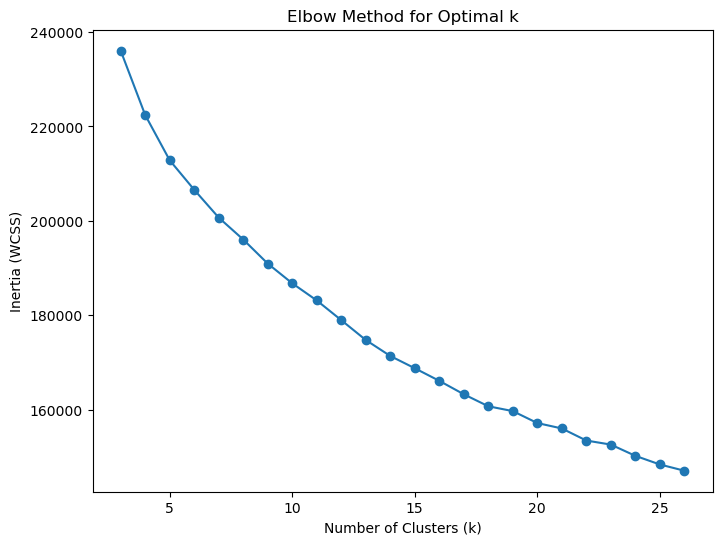

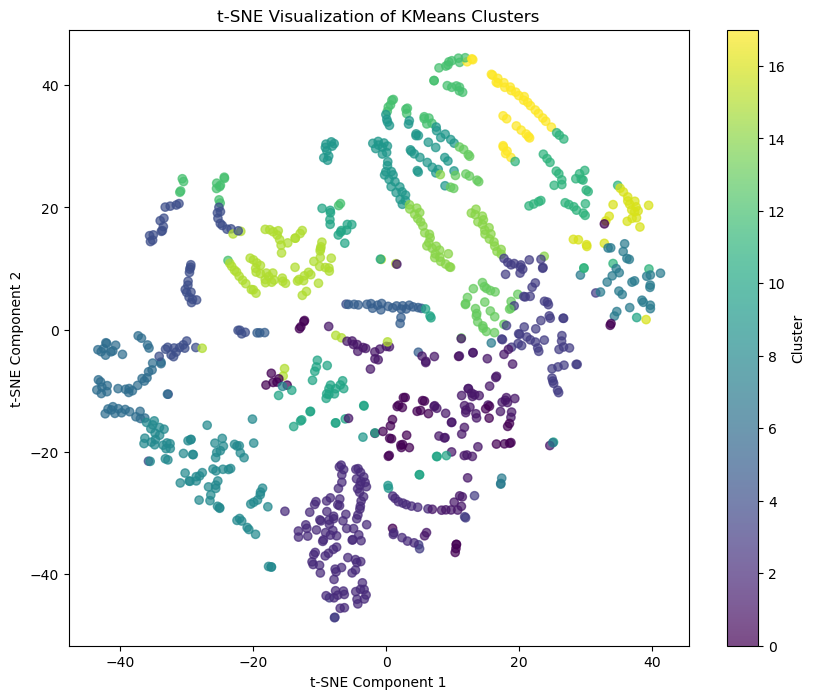

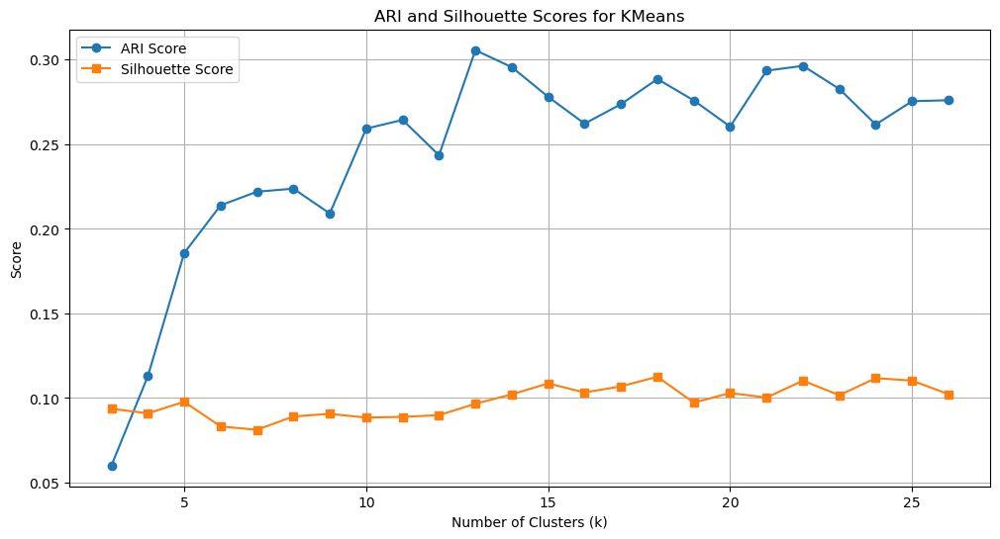

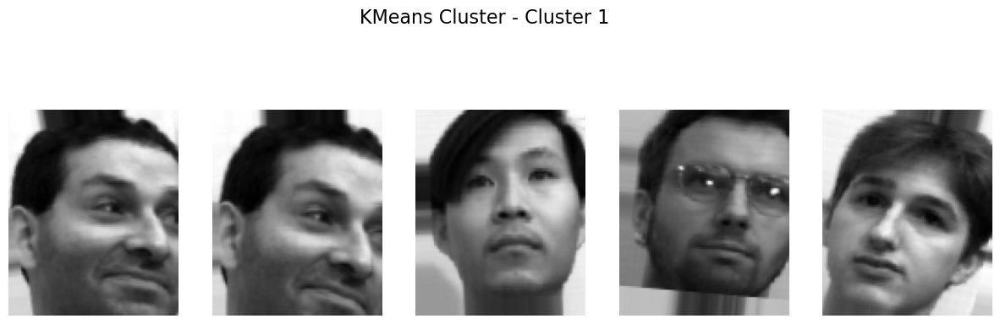

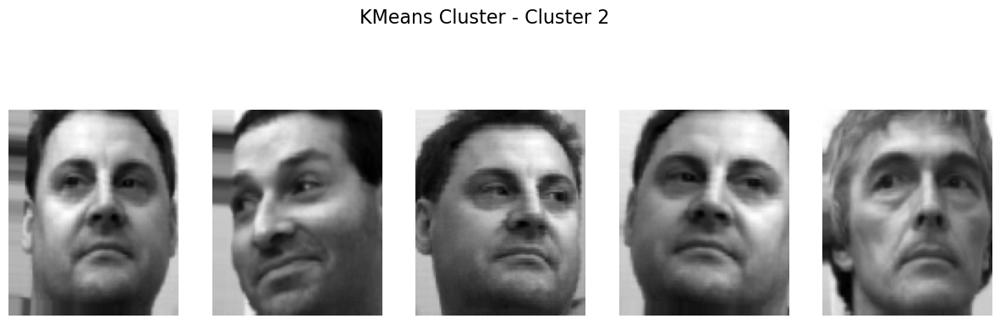

...

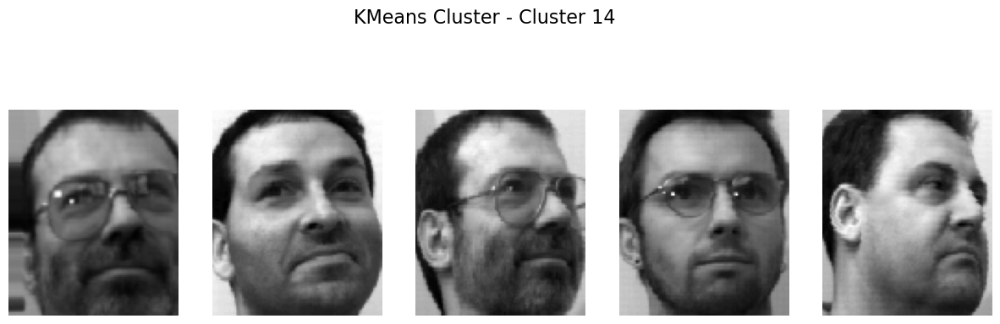

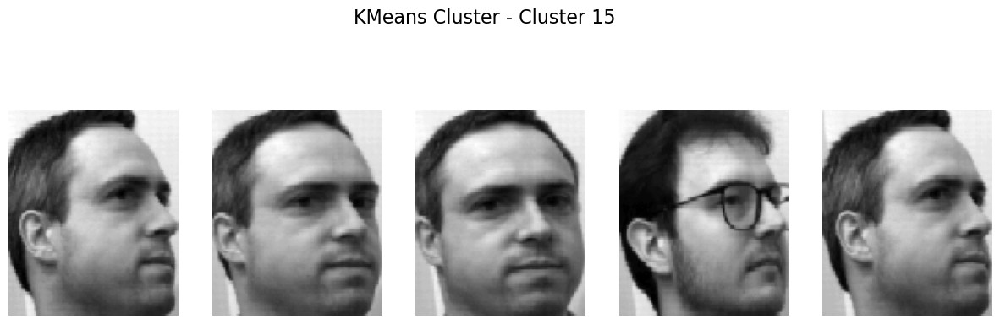

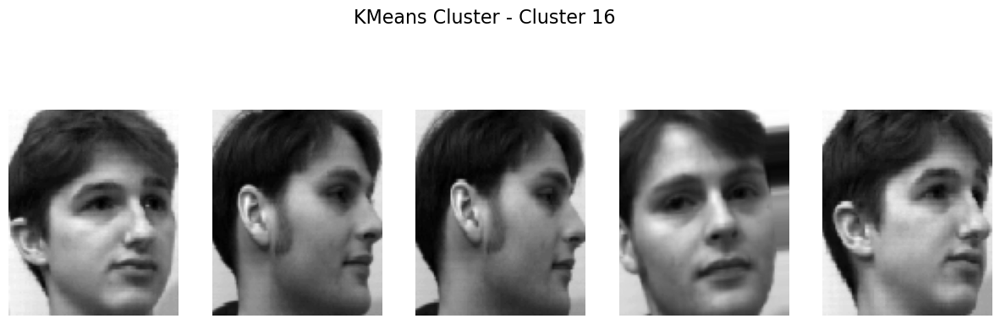

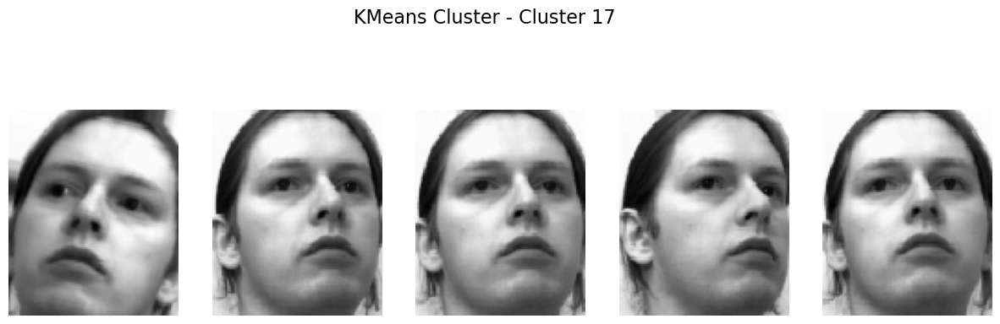

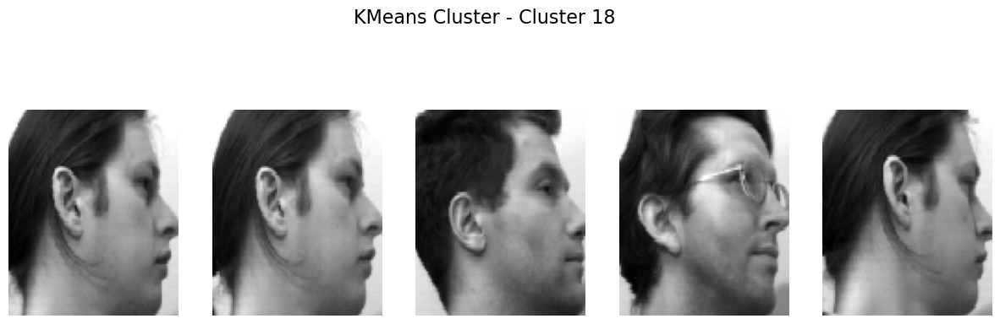

In [13]:
# Adjusted k range, closer to the expected number of clusters
k_values = range(3, 27)
inertias = []
kmeans_per_k = []
ari_scores = []

# Run KMeans clustering for different k values
for k in k_values:
    kmeans = KMeans(n_clusters=k, init="k-means++", n_init=30, random_state=15)
    kmeans.fit(X_pca)
    inertias.append(kmeans.inertia_)
    kmeans_per_k.append(kmeans)
    
    # Calculate ARI for each k
    ari = adjusted_rand_score(y, kmeans.labels_)
    ari_scores.append(ari)

# Calculate silhouette scores and find the best k
silhouette_scores = [silhouette_score(X_pca, model.labels_) for model in kmeans_per_k]
best_index = np.argmax(silhouette_scores)
best_k = k_values[best_index]
best_score = silhouette_scores[best_index]
best_ari = ari_scores[best_index]
print(f"Best k value: {best_k} with a silhouette score of {best_score:.4f}")
print(f"ARI for k = {best_k}: {best_ari:.4f}")

# Plot Elbow Curve
plt.figure(figsize=(8, 6))
plt.plot(k_values, inertias, marker='o')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia (WCSS)")
plt.title("Elbow Method for Optimal k")
plt.show()

# Fit KMeans with the optimal number of clusters found
kmeans_optimal = KMeans(n_clusters=best_k, init="k-means++", n_init=50, random_state=15)
kmeans_optimal.fit(X_pca)
cluster_labels = kmeans_optimal.labels_

# t-SNE Plot
plot_tsne(X_pca, cluster_labels, title="t-SNE Visualization of KMeans Clusters")

# ARI and Silhouette Score Plots
plot_ari_silhouette_scores(ari_scores, silhouette_scores, k_values, model_name="KMeans")

# Image Clustering Visualization
plot_cluster_images(X, cluster_labels, best_k, n_images=5, title="KMeans Cluster")


Optimal number of clusters (k): 24
Optimal covariance type: tied
Best silhouette score: 0.0797
Best Adjusted Rand Index (ARI): 0.3147


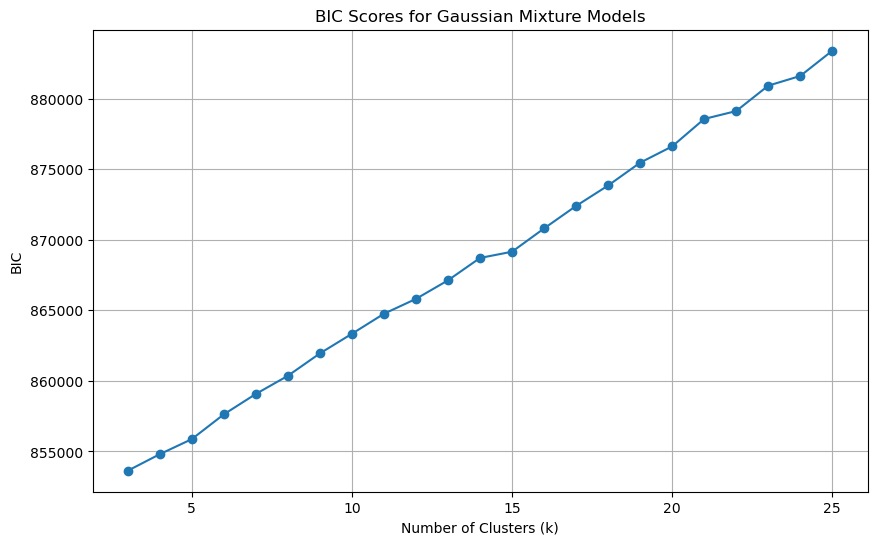

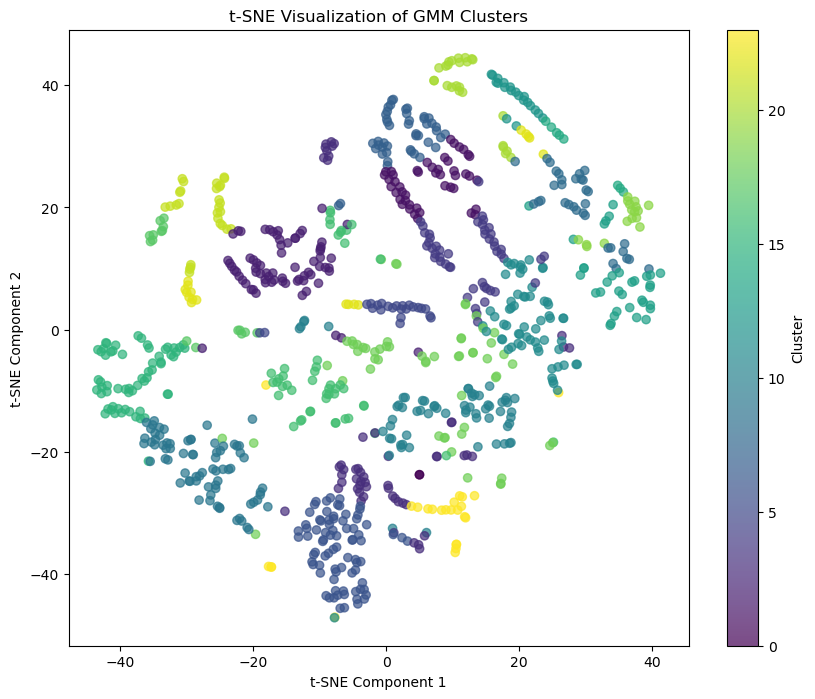

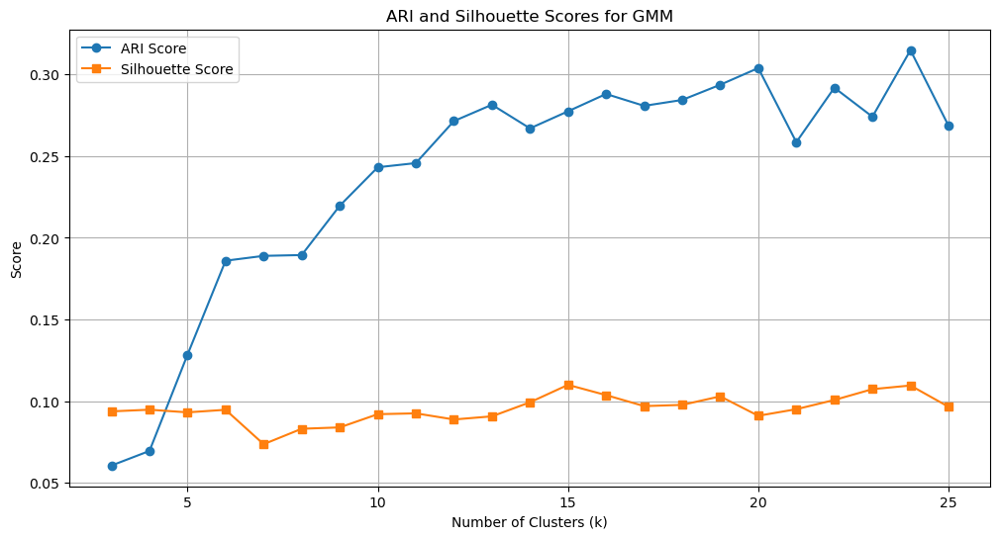

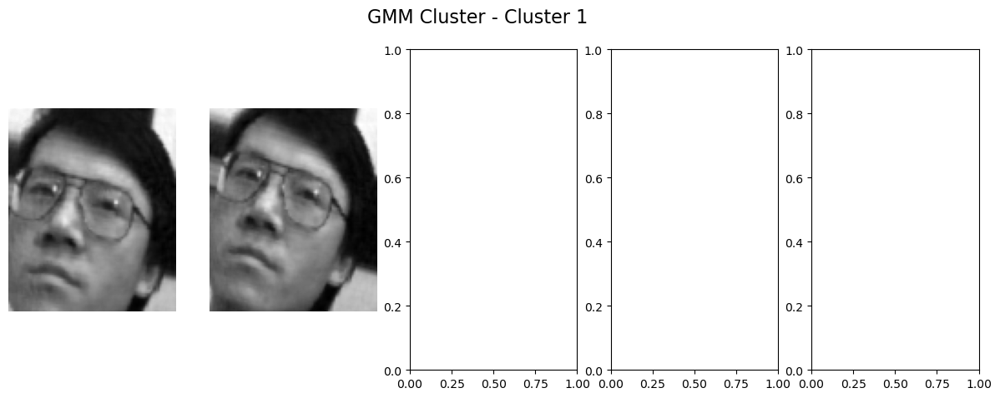

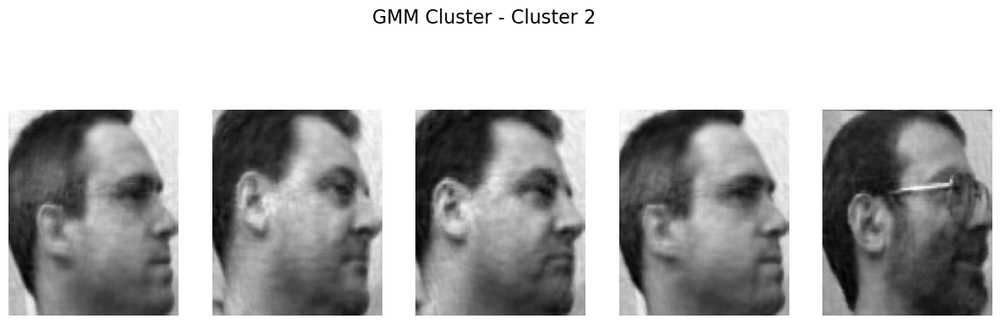

...

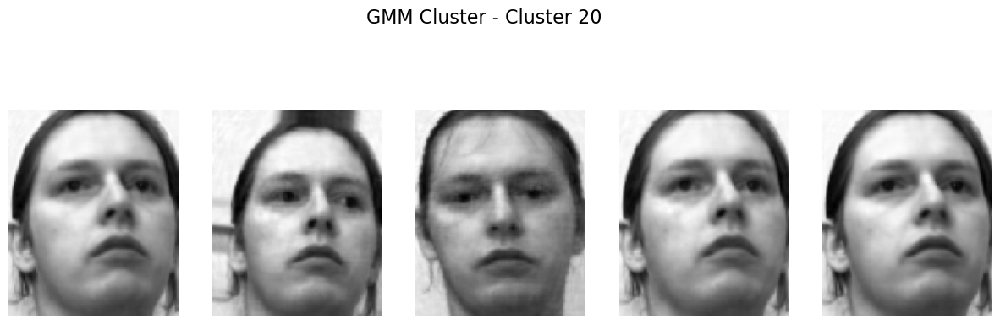

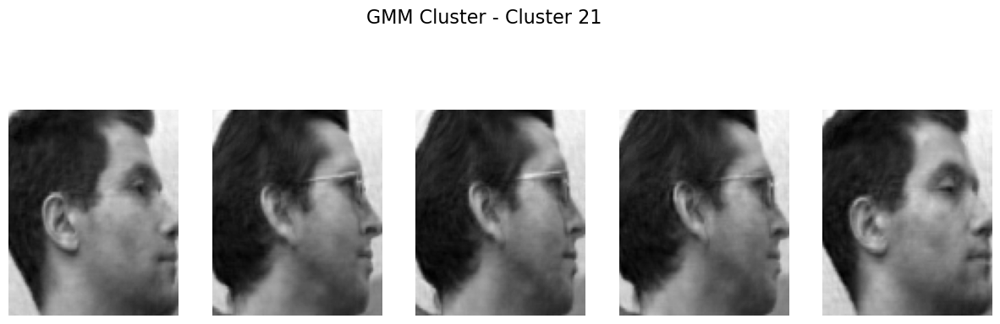

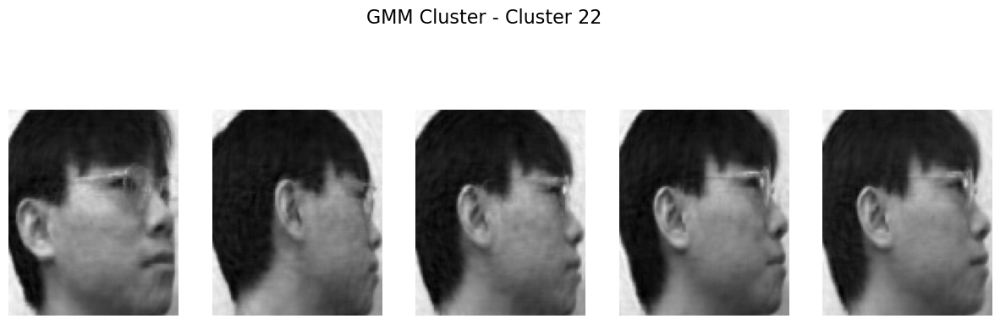

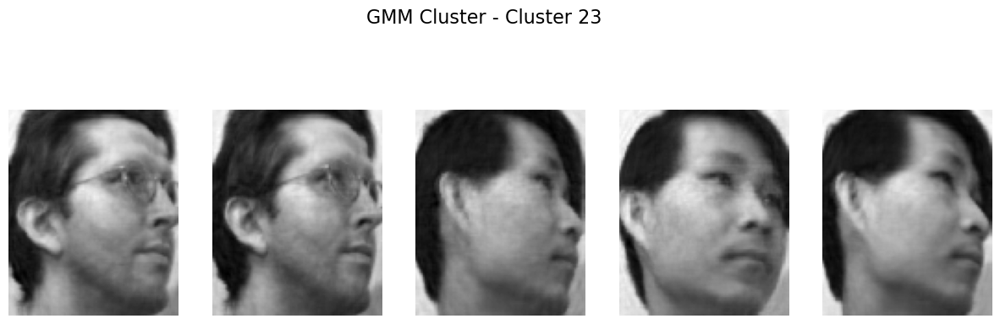

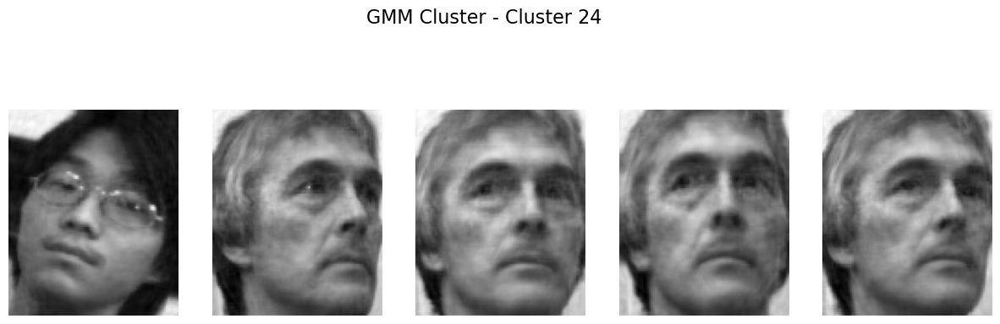

In [14]:


# Hyperparameters for tuning
n_components_range = range(3, 26)  # Adjusted range for expected clusters
covariance_types = ["full", "tied", "spherical", "diag"]
best_ari = -1
best_k = None
best_covariance_type = None
best_gmm = None
bic_scores = []
silhouette_scores = []
ari_scores = []

# Hyperparameter tuning loop
for n_components in n_components_range:
    for covariance_type in covariance_types:
        gmm = GaussianMixture(
            n_components=n_components, 
            covariance_type=covariance_type, 
            random_state=15,
            n_init=10,  # Increase number of initializations
            max_iter=500  # Increase iterations for convergence
        )
        gmm.fit(X_pca)
        
        # Calculate BIC
        bic = gmm.bic(X_pca)
        bic_scores.append((n_components, covariance_type, bic))
        
        # Calculate silhouette score
        cluster_labels = gmm.predict(X_pca)
        silhouette_avg = silhouette_score(X_pca, cluster_labels)
        silhouette_scores.append((n_components, covariance_type, silhouette_avg))
        
        # Calculate ARI
        ari = adjusted_rand_score(y, cluster_labels)
        ari_scores.append((n_components, covariance_type, ari))
        
        # Track the best model based on ARI
        if ari > best_ari:
            best_ari = ari
            best_k = n_components
            best_covariance_type = covariance_type
            best_gmm = gmm

# Optimal parameters
print(f"Optimal number of clusters (k): {best_k}")
print(f"Optimal covariance type: {best_covariance_type}")
print(f"Best silhouette score: {silhouette_scores[-1][2]:.4f}")  # Keep silhouette for comparison
print(f"Best Adjusted Rand Index (ARI): {best_ari:.4f}")

# Plot BIC scores
plt.figure(figsize=(10, 6))
bic_plot_data = [(x[0], x[2]) for x in bic_scores if x[1] == best_covariance_type]
plt.plot([x[0] for x in bic_plot_data], [x[1] for x in bic_plot_data], marker='o')
plt.title("BIC Scores for Gaussian Mixture Models")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("BIC")
plt.grid(True)
plt.show()





# Fit GMM with the optimal parameters found
gmm_best = best_gmm
gmm_labels = gmm_best.predict(X_pca)


# t-SNE Plot
plot_tsne(X_pca, gmm_labels, title="t-SNE Visualization of GMM Clusters")

# ARI and Silhouette Score Plots
n_components_values = [x[0] for x in silhouette_scores if x[1] == best_covariance_type]
ari_scores_gmm = [x[2] for x in ari_scores if x[1] == best_covariance_type]
silhouette_scores_gmm = [x[2] for x in silhouette_scores if x[1] == best_covariance_type]
plot_ari_silhouette_scores(ari_scores_gmm, silhouette_scores_gmm, n_components_values, model_name="GMM")


# Reconstruct images from PCA-reduced data
X_reconstructed = pca.inverse_transform(X_pca)

# Image Clustering Visualization
plot_cluster_images(X_reconstructed, gmm_labels, best_k, n_images=5, title="GMM Cluster")





In [15]:
from sklearn.metrics import pairwise_distances

# Normalize data for DBSCAN
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Grid search for eps and min_samples
eps_range = np.arange(0.1, 8.0, 0.5) 
min_samples_range = range(2, 11) 
best_ari = -1
best_dbscan_model = None

# Store results for analysis
results = []

for eps in eps_range:
    for min_samples in min_samples_range:
        # DBSCAN clustering
        dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric="euclidean")
        dbscan_labels = dbscan.fit_predict(X_scaled)
        
        # Check clusters (excluding noise)
        n_clusters = len(set(dbscan_labels) - {-1})
        noise_percentage = np.sum(dbscan_labels == -1) / len(dbscan_labels) * 100
        
        if n_clusters > 1:  # Silhouette and ARI require at least 2 clusters
            silhouette = silhouette_score(X_scaled[dbscan_labels != -1], dbscan_labels[dbscan_labels != -1])
            ari = adjusted_rand_score(y, dbscan_labels)
            results.append((eps, min_samples, n_clusters, noise_percentage, silhouette, ari))
            
            # Update best model
            if ari > best_ari:
                best_ari = ari
                best_dbscan_model = dbscan

# Display the best DBSCAN model
if best_dbscan_model:
    best_dbscan_labels = best_dbscan_model.labels_
    n_clusters = len(set(best_dbscan_labels) - {-1})
    noise_percentage = np.sum(best_dbscan_labels == -1) / len(best_dbscan_labels) * 100
    
    print(f"Best DBSCAN Configuration:")
    print(f"eps: {best_dbscan_model.eps}")
    print(f"min_samples: {best_dbscan_model.min_samples}")
    print(f"Clusters (excluding noise): {n_clusters}")
    print(f"Noise percentage: {noise_percentage:.2f}%")
    print(f"Best Adjusted Rand Index (ARI): {best_ari:.4f}")
    
    # t-SNE Plot
    tsne = TSNE(n_components=2, random_state=42)
    X_tsne = tsne.fit_transform(X_scaled)

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=best_dbscan_labels, cmap="viridis", alpha=0.7)
    plt.colorbar(scatter, label="Cluster")
    plt.title("t-SNE Visualization of DBSCAN Clusters")
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.show()

    # Analyze Silhouette and ARI
    results_sorted = sorted(results, key=lambda x: x[5], reverse=True)  # Sort by ARI
    print("\nTop Configurations:")
    for res in results_sorted[:5]:
        print(f"eps={res[0]:.2f}, min_samples={res[1]}, Clusters={res[2]}, "
              f"Noise={res[3]:.2f}%, Silhouette={res[4]:.4f}, ARI={res[5]:.4f}")
else:
    print("No suitable clusters found.")


No suitable clusters found.


Cosine Agglomerative: Clusters=2, Silhouette Score=0.1286, ARI=0.0157
Cosine Agglomerative: Clusters=3, Silhouette Score=0.1310, ARI=0.0899
Cosine Agglomerative: Clusters=4, Silhouette Score=0.1390, ARI=0.1212
Cosine Agglomerative: Clusters=5, Silhouette Score=0.1330, ARI=0.1242
Cosine Agglomerative: Clusters=6, Silhouette Score=0.1392, ARI=0.1295
Cosine Agglomerative: Clusters=7, Silhouette Score=0.1367, ARI=0.1416
Cosine Agglomerative: Clusters=8, Silhouette Score=0.1387, ARI=0.1537
Cosine Agglomerative: Clusters=9, Silhouette Score=0.1391, ARI=0.1546
Cosine Agglomerative: Clusters=10, Silhouette Score=0.1333, ARI=0.1587
Cosine Agglomerative: Clusters=11, Silhouette Score=0.1402, ARI=0.1819
Cosine Agglomerative: Clusters=12, Silhouette Score=0.1399, ARI=0.1800
Cosine Agglomerative: Clusters=13, Silhouette Score=0.1384, ARI=0.1823
Cosine Agglomerative: Clusters=14, Silhouette Score=0.1543, ARI=0.2467
Cosine Agglomerative: Clusters=15, Silhouette Score=0.1503, ARI=0.2460
Cosine Agglome

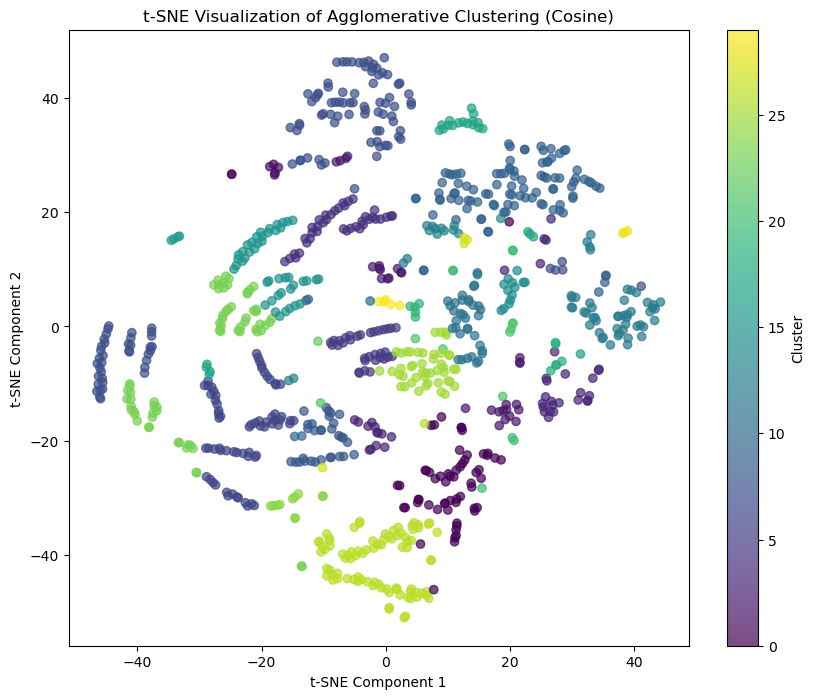

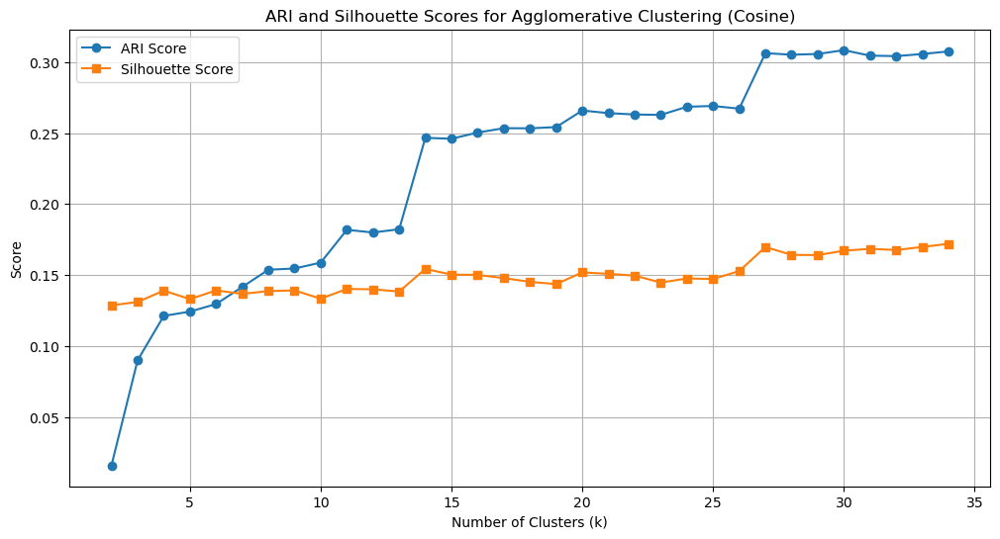

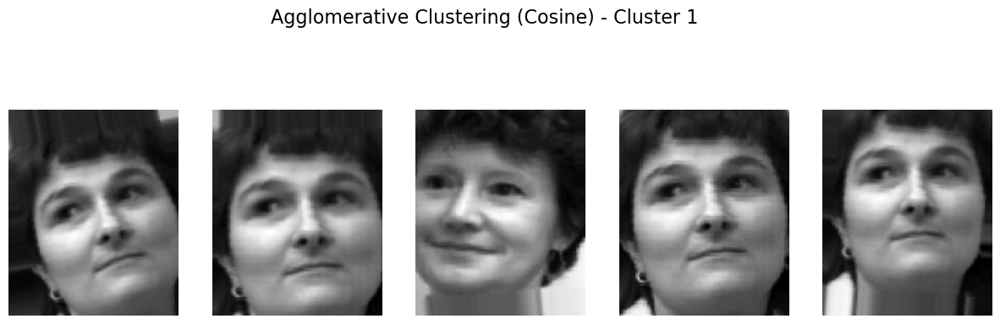

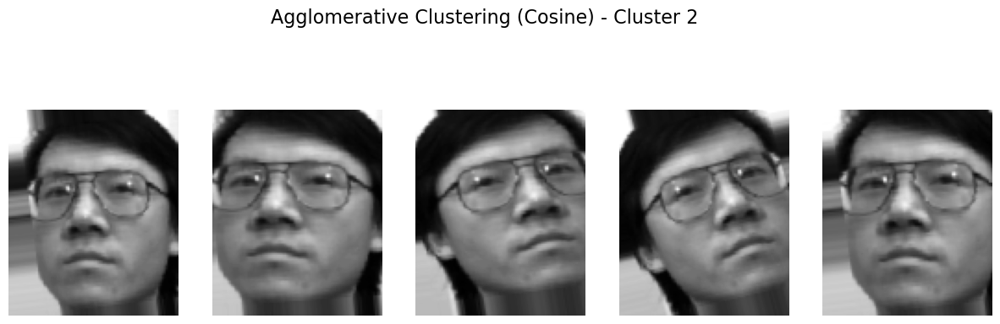

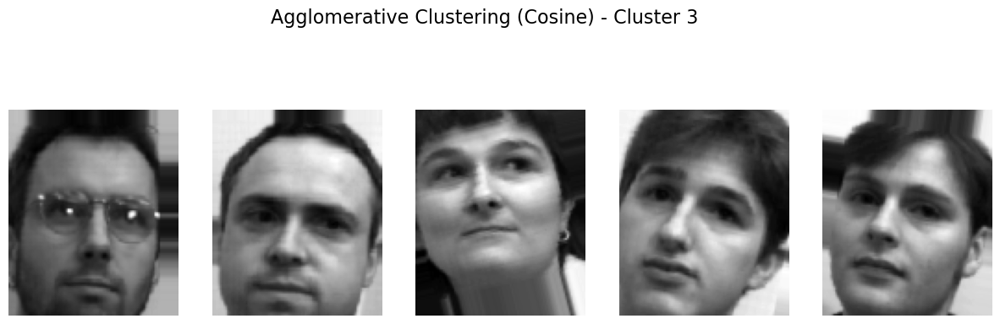

...

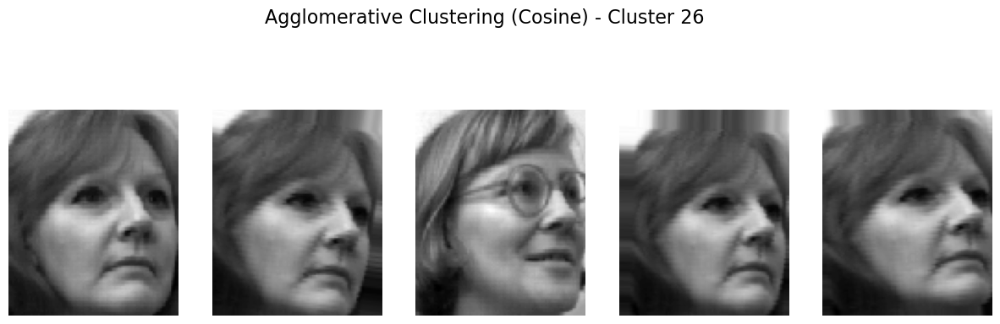

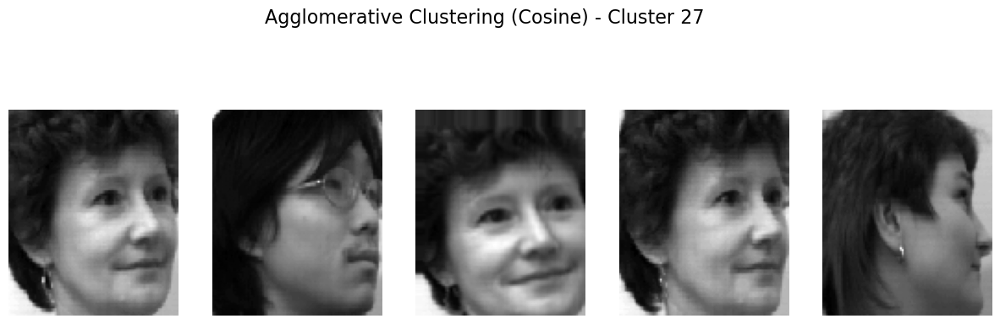

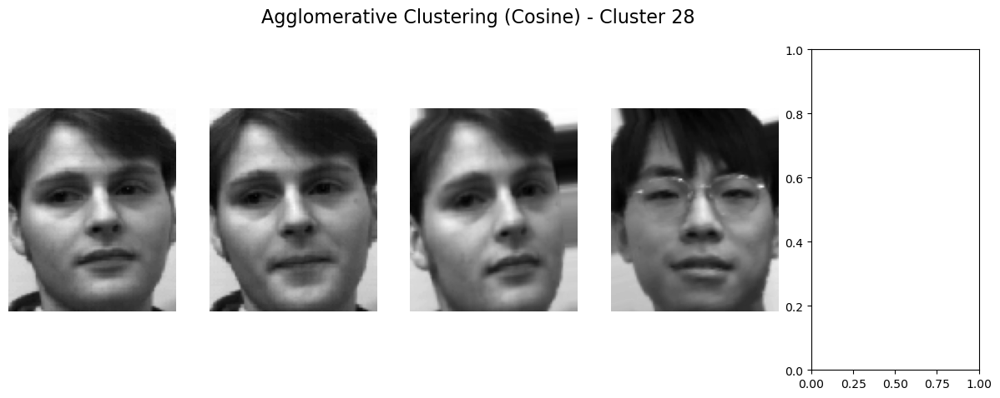

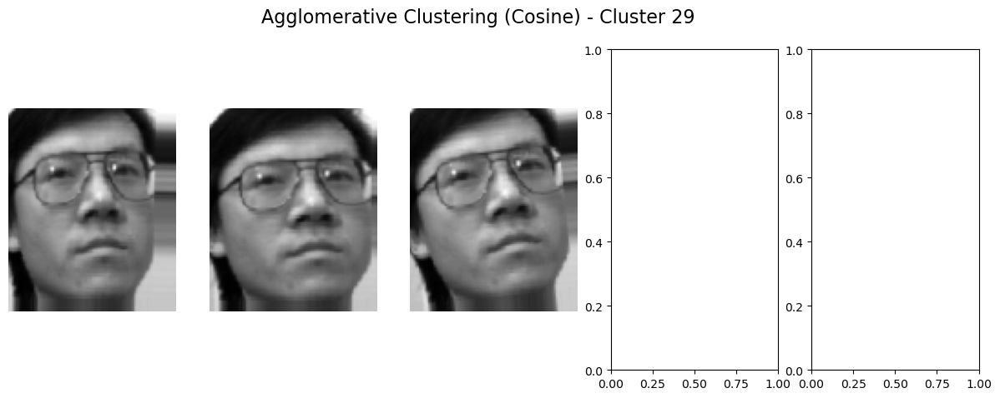

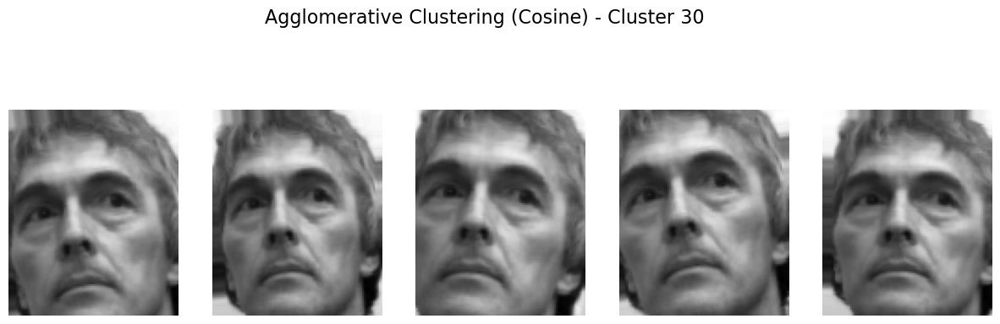

In [16]:


# Agglomerative Clustering with cosine affinity
n_clusters_range = range(2, 35) 
silhouette_scores_cosine = []
ari_scores_cosine = []
labels_cosine_list = []

for n_clusters in n_clusters_range:
    agglomerative_cosine = AgglomerativeClustering(
        n_clusters=n_clusters, affinity="cosine", linkage="average"
    )
    cluster_labels = agglomerative_cosine.fit_predict(X_scaled)
    labels_cosine_list.append(cluster_labels)
    
    # Silhouette score for cosine affinity
    silhouette_avg_cosine = silhouette_score(X_scaled, cluster_labels, metric="cosine")
    silhouette_scores_cosine.append(silhouette_avg_cosine)
    
    # Adjusted Rand Index
    ari_cosine = adjusted_rand_score(y, cluster_labels)
    ari_scores_cosine.append(ari_cosine)
    print(f"Cosine Agglomerative: Clusters={n_clusters}, Silhouette Score={silhouette_avg_cosine:.4f}, ARI={ari_cosine:.4f}")


# Best results based on ARI
best_index_ari = max(range(len(ari_scores_cosine)), key=ari_scores_cosine.__getitem__)
best_n_clusters_ari = n_clusters_range[best_index_ari]
best_ari_cosine = ari_scores_cosine[best_index_ari]
best_labels_cosine_ari = labels_cosine_list[best_index_ari]

print(f"\nBest Cosine Agglomerative Clustering Based on ARI:")
print(f"Number of Clusters: {best_n_clusters_ari}")
print(f"ARI: {best_ari_cosine:.4f}")


# t-SNE Plot
plot_tsne(X_scaled, best_labels_cosine_ari, title="t-SNE Visualization of Agglomerative Clustering (Cosine)")

# ARI and Silhouette Score Plots
plot_ari_silhouette_scores(ari_scores_cosine, silhouette_scores_cosine, n_clusters_range, model_name="Agglomerative Clustering (Cosine)")

# Image Clustering Visualization
plot_cluster_images(X, best_labels_cosine_ari, best_n_clusters_ari, n_images=5, title="Agglomerative Clustering (Cosine)")


Euclidean Agglomerative: Clusters=2, Silhouette Score=0.2077, ARI=0.0259
Euclidean Agglomerative: Clusters=3, Silhouette Score=0.0659, ARI=0.0605
Euclidean Agglomerative: Clusters=4, Silhouette Score=0.0664, ARI=0.1164
Euclidean Agglomerative: Clusters=5, Silhouette Score=0.0712, ARI=0.1049
Euclidean Agglomerative: Clusters=6, Silhouette Score=0.0675, ARI=0.1401
Euclidean Agglomerative: Clusters=7, Silhouette Score=0.0622, ARI=0.1824
Euclidean Agglomerative: Clusters=8, Silhouette Score=0.0672, ARI=0.1800
Euclidean Agglomerative: Clusters=9, Silhouette Score=0.0739, ARI=0.1851
Euclidean Agglomerative: Clusters=10, Silhouette Score=0.0648, ARI=0.2040
Euclidean Agglomerative: Clusters=11, Silhouette Score=0.0670, ARI=0.2029
Euclidean Agglomerative: Clusters=12, Silhouette Score=0.0688, ARI=0.2373
Euclidean Agglomerative: Clusters=13, Silhouette Score=0.0685, ARI=0.2428
Euclidean Agglomerative: Clusters=14, Silhouette Score=0.0704, ARI=0.2693
Euclidean Agglomerative: Clusters=15, Silhouet

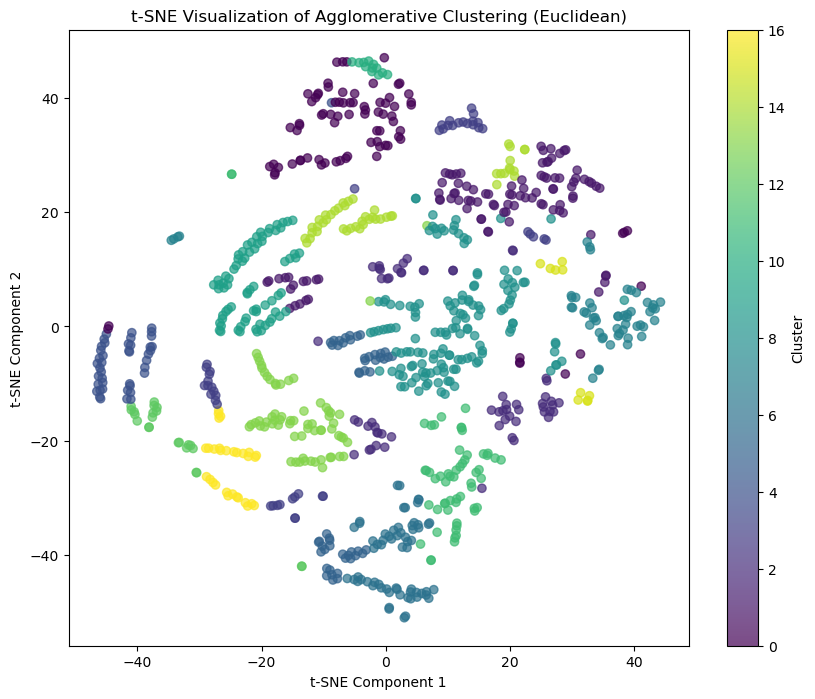

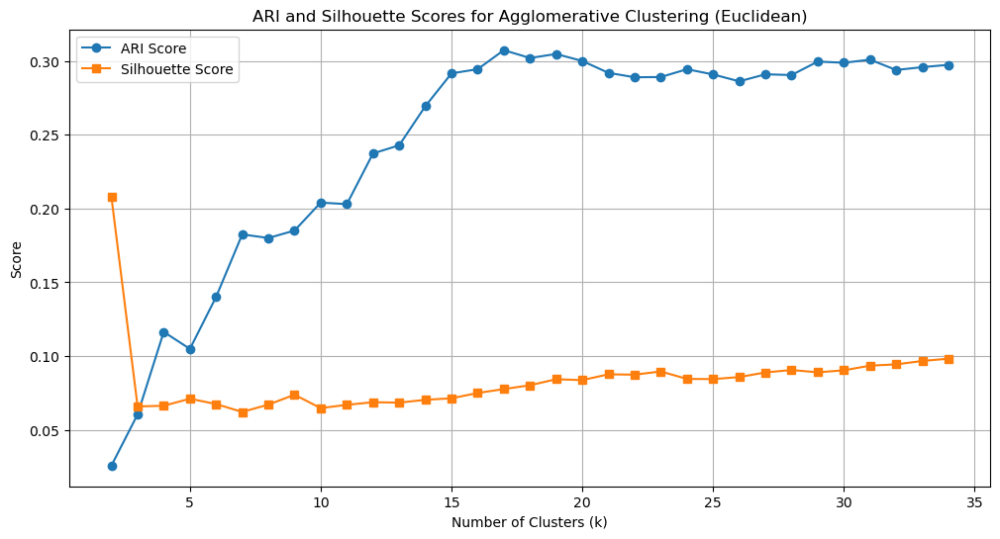

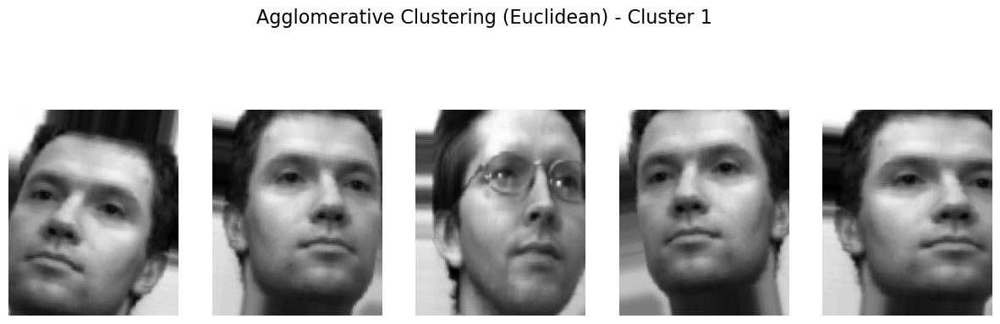

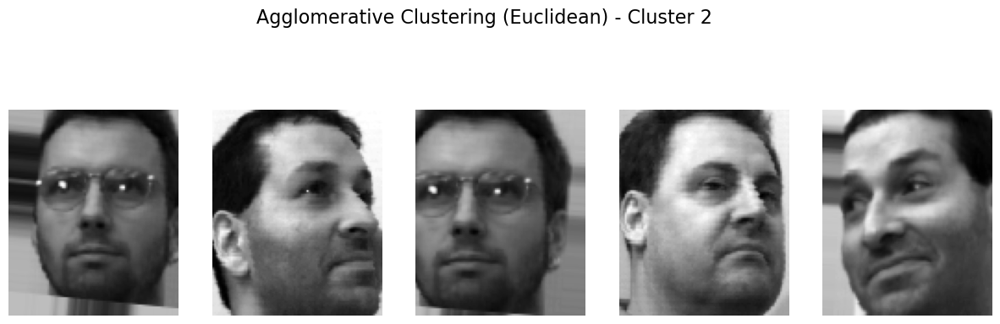

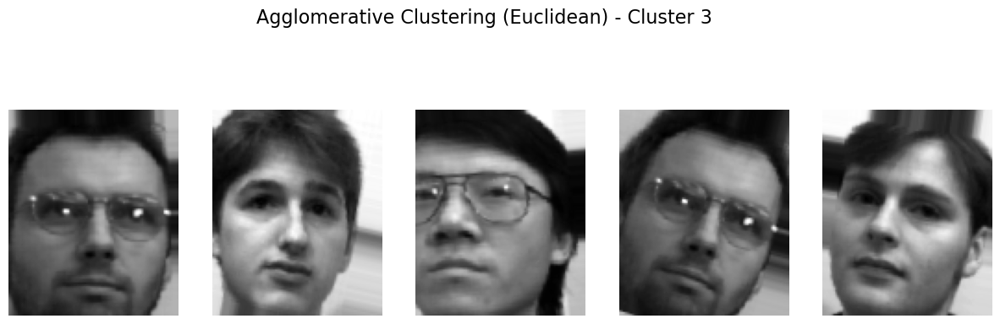

...

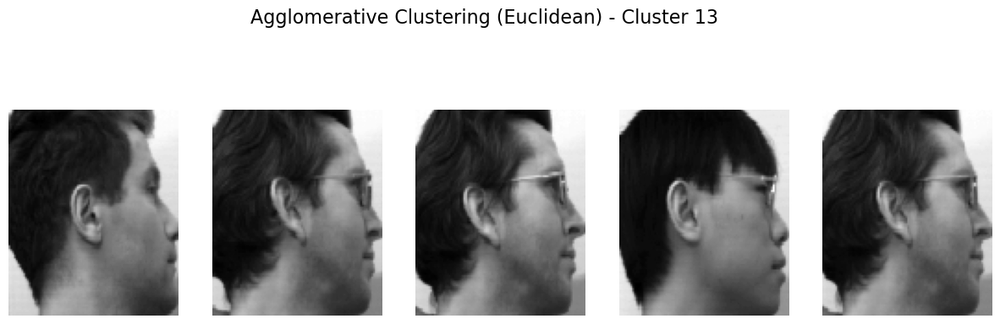

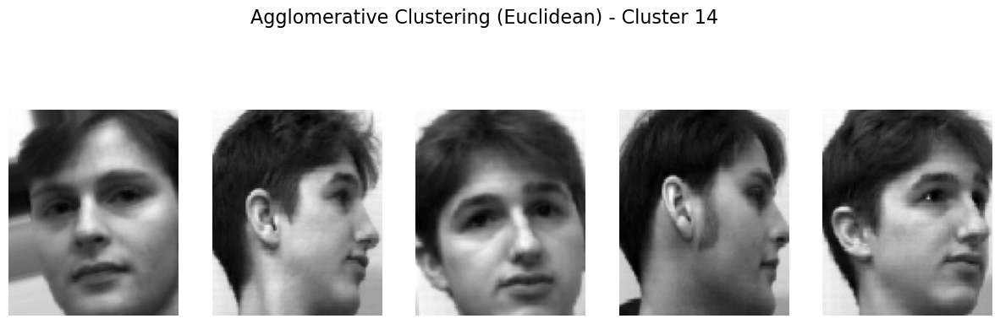

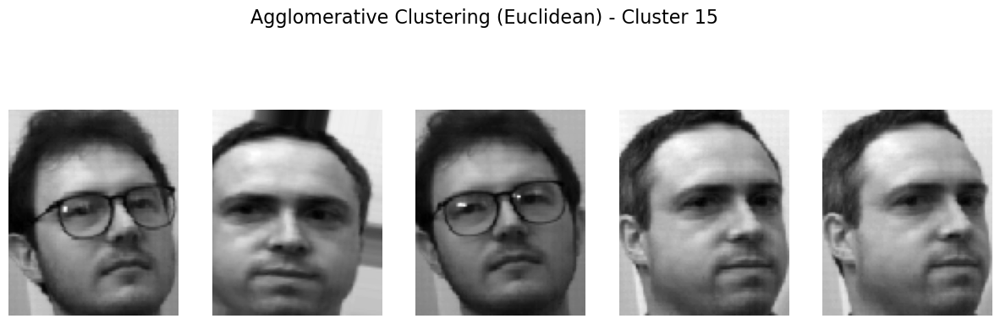

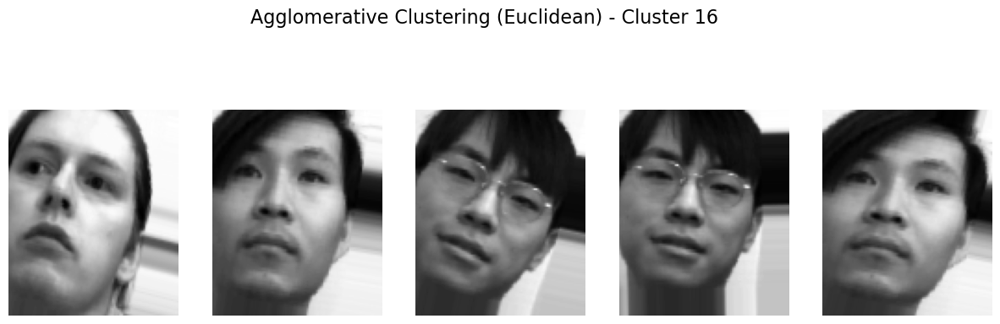

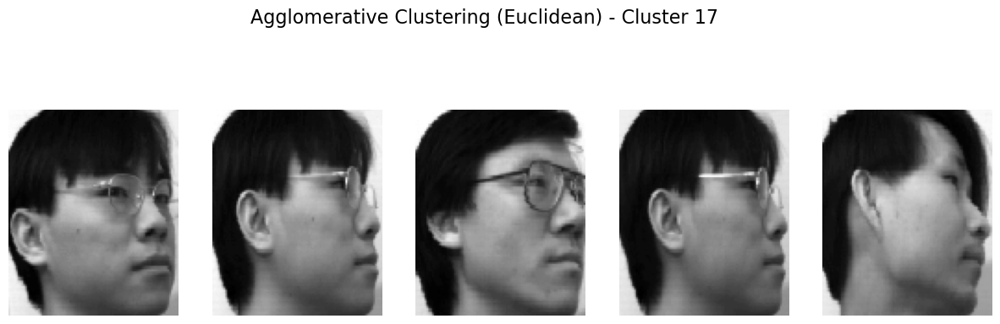

In [17]:

# Agglomerative Clustering with Euclidean affinity
best_model_euclidean = None
best_silhouette_euclidean = -1
best_ari_euclidean = -1
best_labels_euclidean = None
silhouette_scores_euclidean = []
ari_scores_euclidean = []

for n_clusters in n_clusters_range:
    agglomerative_euclidean = AgglomerativeClustering(
        n_clusters=n_clusters, affinity="euclidean", linkage="ward"
    )
    cluster_labels = agglomerative_euclidean.fit_predict(X_scaled)
    
    # Silhouette score for Euclidean affinity
    silhouette_avg_euclidean = silhouette_score(X_scaled, cluster_labels, metric="euclidean")
    silhouette_scores_euclidean.append(silhouette_avg_euclidean)
    
    # Adjusted Rand Index
    ari_euclidean = adjusted_rand_score(y, cluster_labels)
    ari_scores_euclidean.append(ari_euclidean)
    
    print(f"Euclidean Agglomerative: Clusters={n_clusters}, Silhouette Score={silhouette_avg_euclidean:.4f}, ARI={ari_euclidean:.4f}")
    
    # Track the best model based on ARI
    if ari_euclidean > best_ari_euclidean:
        best_ari_euclidean = ari_euclidean
        best_model_euclidean = agglomerative_euclidean
        best_labels_euclidean = cluster_labels

# Best results
if best_model_euclidean:
    print(f"\nBest Euclidean Agglomerative Clustering:")
    print(f"Number of Clusters: {best_model_euclidean.n_clusters_}")
    print(f"Silhouette Score: {max(silhouette_scores_euclidean):.4f}")
    print(f"Adjusted Rand Index (ARI): {best_ari_euclidean:.4f}")


# t-SNE Plot
plot_tsne(X_scaled, best_labels_euclidean, title="t-SNE Visualization of Agglomerative Clustering (Euclidean)")

# ARI and Silhouette Score Plots
plot_ari_silhouette_scores(ari_scores_euclidean, silhouette_scores_euclidean, n_clusters_range, model_name="Agglomerative Clustering (Euclidean)")

# Image Clustering Visualization
plot_cluster_images(X, best_labels_euclidean, best_model_euclidean.n_clusters_, n_images=5, title="Agglomerative Clustering (Euclidean)")



In [18]:


# Reshape input data for CNN (112x92 is the image size)
X_reshaped = X.reshape(-1, 112, 92, 1)

# Define an optimized CNN autoencoder
def build_optimized_cnn_autoencoder():
    input_img = Input(shape=(112, 92, 1))
    
    # Encoder
    x = Conv2D(32, (3, 3), activation="relu", padding="same")(input_img)
    x = MaxPooling2D((2, 2), padding="same")(x)
    x = Dropout(0.3)(x)
    x = Conv2D(64, (3, 3), activation="relu", padding="same")(x)
    x = MaxPooling2D((2, 2), padding="same")(x)
    x = Dropout(0.3)(x)
    x = Conv2D(128, (3, 3), activation="relu", padding="same")(x)
    encoded = MaxPooling2D((2, 2), padding="same")(x)
    
    # Decoder
    x = Conv2D(128, (3, 3), activation="relu", padding="same")(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(64, (3, 3), activation="relu", padding="same")(x)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation="relu", padding="same")(x)
    x = UpSampling2D((2, 2))(x)
    
    # Final Conv2D layer with cropping to ensure exact output size
    decoded = Conv2D(1, (3, 3), activation="sigmoid", padding="same")(x)
    decoded = tf.image.resize_with_crop_or_pad(decoded, 112, 92)  # Ensure final output is exactly (112, 92)
    
    # Autoencoder model
    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer=Adam(learning_rate=0.0005), loss="mse")  # Reduced learning rate
    
    # Encoder model
    encoder = Model(input_img, encoded)
    
    return autoencoder, encoder

# Build and train the optimized CNN autoencoder
autoencoder, encoder = build_optimized_cnn_autoencoder()
autoencoder.summary()

# Train the model
autoencoder.fit(
    X_reshaped, X_reshaped,
    epochs=50,  # Increased epochs
    batch_size=128,  # Reduced batch size for finer gradient updates
    validation_split=0.2,
    verbose=1
)

# Extract latent representations
latent_representations = encoder.predict(X_reshaped)
latent_representations_flat = latent_representations.reshape(latent_representations.shape[0], -1)




Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 112, 92, 1)]      0         
                                                                 
 conv2d (Conv2D)             (None, 112, 92, 32)       320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 56, 46, 32)        0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 56, 46, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 56, 46, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 28, 23, 64)        0         
 g2D)                                                      

In [19]:
from sklearn.decomposition import PCA

# Reduce dimensionality of latent representations
latent_representations_pca = pca.fit_transform(latent_representations_flat)

print(f"Original shape: {latent_representations_flat.shape}")
print(f"Reduced shape after PCA: {latent_representations_pca.shape}")


Original shape: (960, 21504)
Reduced shape after PCA: (960, 492)


DBSCAN (eps=2.14, min_samples=2): ARI=0.6623, Silhouette=0.1992, Clusters=79, Noise=29.58%
DBSCAN (eps=2.15, min_samples=2): ARI=0.6662, Silhouette=0.1990, Clusters=77, Noise=29.17%
DBSCAN (eps=2.16, min_samples=2): ARI=0.6404, Silhouette=0.1970, Clusters=76, Noise=28.96%
DBSCAN (eps=2.17, min_samples=2): ARI=0.6370, Silhouette=0.1980, Clusters=76, Noise=28.54%
DBSCAN (eps=2.18, min_samples=2): ARI=0.6268, Silhouette=0.1901, Clusters=73, Noise=28.44%
DBSCAN (eps=2.19, min_samples=2): ARI=0.6321, Silhouette=0.1947, Clusters=72, Noise=28.33%
DBSCAN (eps=2.20, min_samples=2): ARI=0.6317, Silhouette=0.1950, Clusters=72, Noise=28.02%
DBSCAN (eps=2.21, min_samples=2): ARI=0.6317, Silhouette=0.1950, Clusters=72, Noise=28.02%
DBSCAN (eps=2.22, min_samples=2): ARI=0.5937, Silhouette=0.1819, Clusters=69, Noise=28.02%
DBSCAN (eps=2.23, min_samples=2): ARI=0.5933, Silhouette=0.1816, Clusters=68, Noise=27.71%
DBSCAN (eps=2.24, min_samples=2): ARI=0.5933, Silhouette=0.1816, Clusters=68, Noise=27.71%

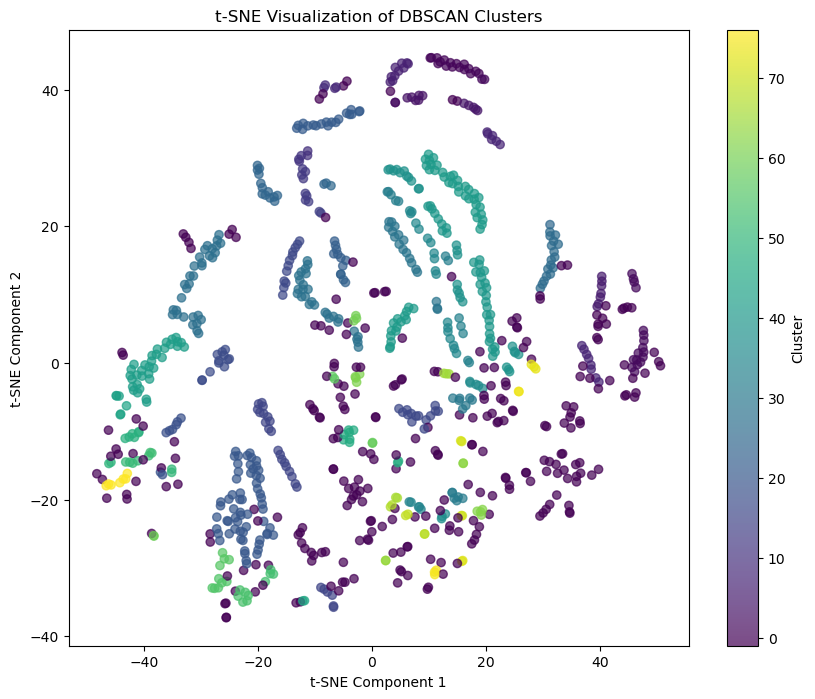

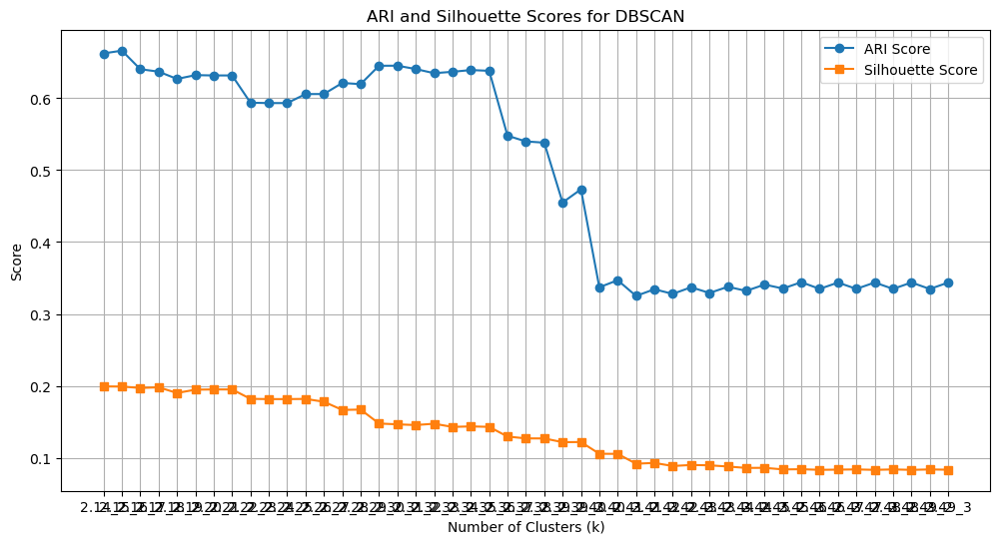

In [20]:
# Precompute the pairwise distance matrix
distance_matrix = pairwise_distances(latent_representations_pca, metric="euclidean")

# Refine DBSCAN hyperparameters with tighter ranges
eps_values = np.arange(2, 2.5, 0.01)  # Fine-tuning eps range
min_samples_values = range(2, 11)  # Fine-tuning min_samples range
best_dbscan_ari = -1
best_dbscan_model = None

# Store results for plotting
results = []

# Fine-tuning loop with precomputed distances
for eps in eps_values:
    for min_samples in min_samples_values:
        dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric="precomputed")
        dbscan_labels = dbscan.fit_predict(distance_matrix)
        
        # Calculate noise percentage
        noise_count = np.sum(dbscan_labels == -1)
        total_count = len(dbscan_labels)
        noise_percentage = (noise_count / total_count) * 100
        
        # Exclude noise (-1 labels) for ARI and silhouette scores
        valid_mask = dbscan_labels != -1
        num_clusters = len(set(dbscan_labels[valid_mask]))
        
        # Check if noise percentage is below 30%
        if noise_percentage < 30:
            if num_clusters >= 15:  # Ensure at least 15 clusters
                ari = adjusted_rand_score(y[valid_mask], dbscan_labels[valid_mask])
                silhouette_avg = silhouette_score(latent_representations_pca[valid_mask], dbscan_labels[valid_mask])

                results.append((eps, min_samples, num_clusters, ari, silhouette_avg, noise_percentage))
                
                if ari > best_dbscan_ari:
                    best_dbscan_ari = ari
                    best_dbscan_model = dbscan
                
                print(f"DBSCAN (eps={eps:.2f}, min_samples={min_samples}): ARI={ari:.4f}, Silhouette={silhouette_avg:.4f}, "
                      f"Clusters={num_clusters}, Noise={noise_percentage:.2f}%")

# Best DBSCAN model
if best_dbscan_model:
    print(f"\nBest DBSCAN: eps={best_dbscan_model.eps}, min_samples={best_dbscan_model.min_samples}, ARI={best_dbscan_ari:.4f}")
    dbscan_labels = best_dbscan_model.labels_
    num_clusters = len(set(dbscan_labels)) - (1 if -1 in dbscan_labels else 0)
    noise_percentage = (np.sum(dbscan_labels == -1) / len(dbscan_labels)) * 100
    print(f"Number of Clusters: {num_clusters}, Noise Percentage: {noise_percentage:.2f}%")
    
    # t-SNE Plot
    plot_tsne(latent_representations_pca, dbscan_labels, title="t-SNE Visualization of DBSCAN Clusters")
else:
    print("DBSCAN did not find sufficient clusters.")



# ARI and Silhouette Score Plots
eps_values_combined = [f"{eps:.2f}_{min_samples}" for eps, min_samples, _, _, _, _ in results]
ari_scores_dbscan = [ari for _, _, _, ari, _, _ in results]
silhouette_scores_dbscan = [silhouette for _, _, _, _, silhouette, _ in results]
plot_ari_silhouette_scores(ari_scores_dbscan, silhouette_scores_dbscan, eps_values_combined, model_name="DBSCAN")


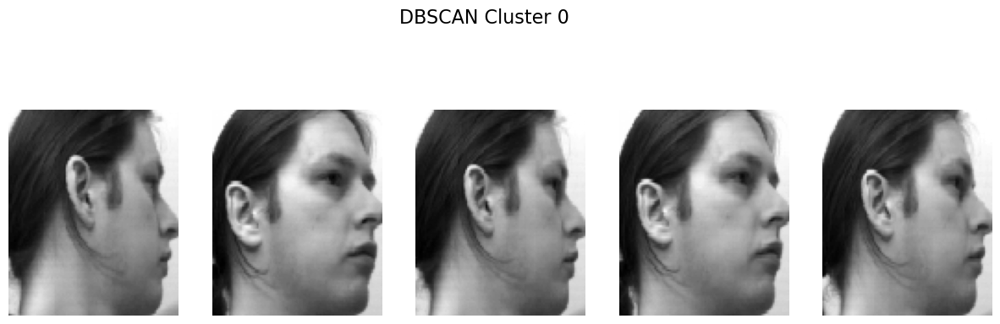

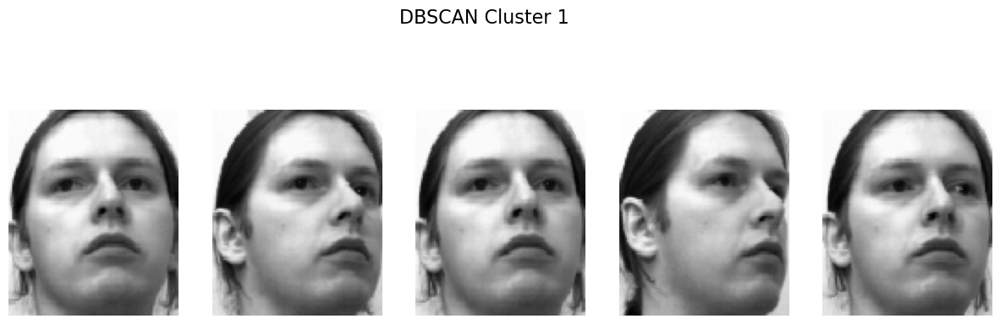

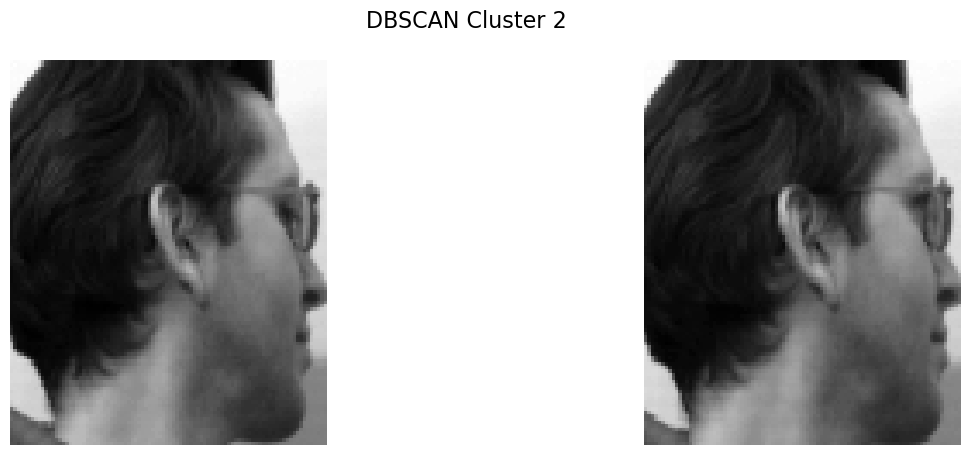

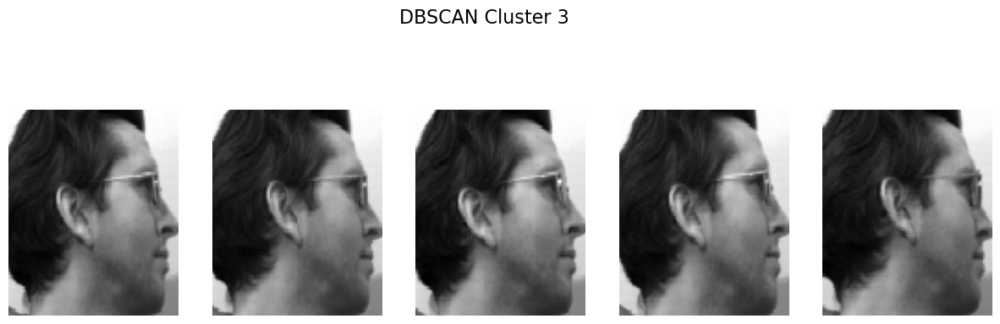

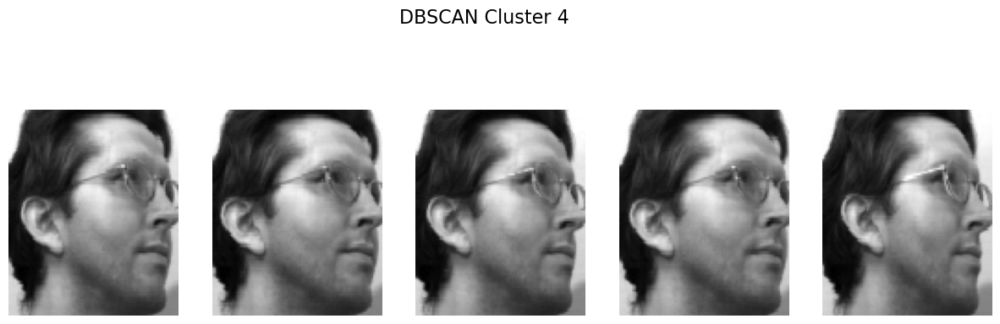

...

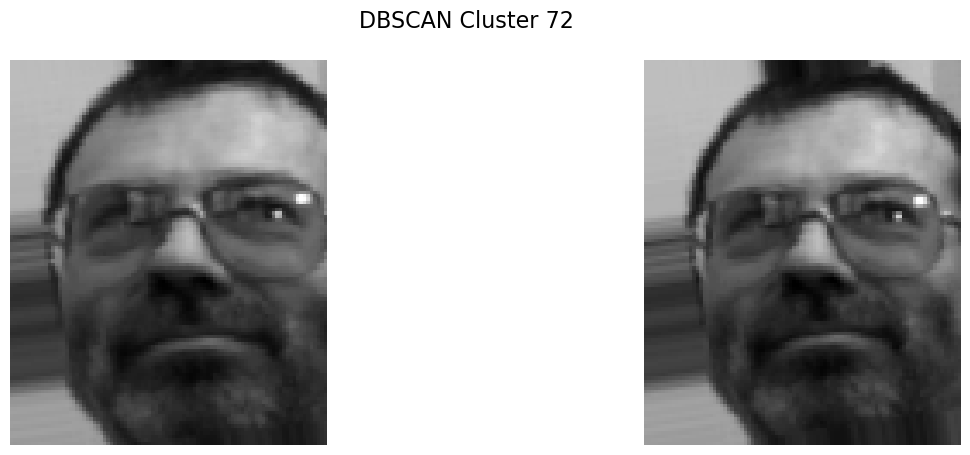

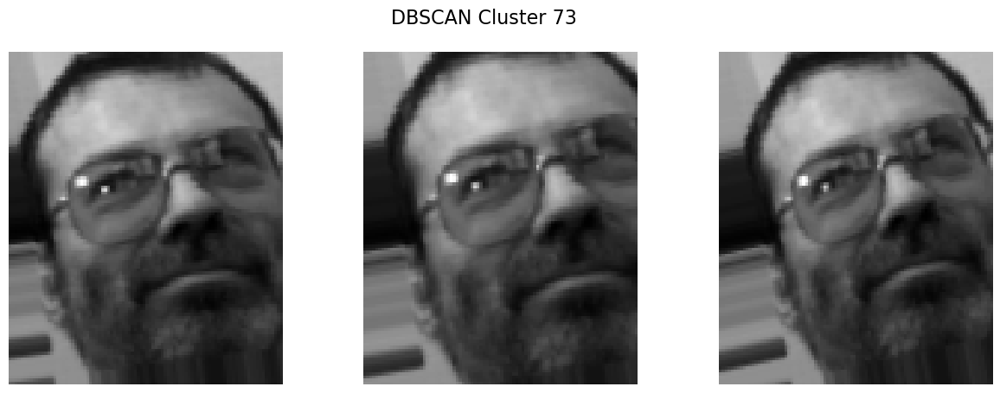

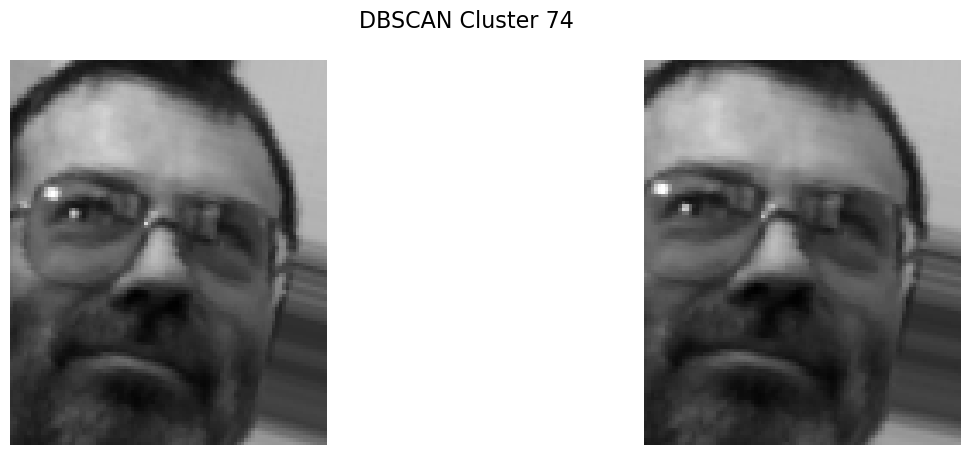

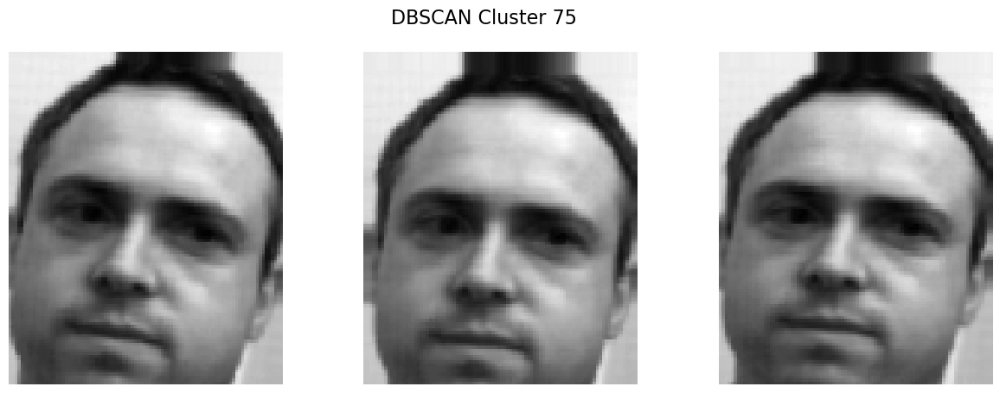

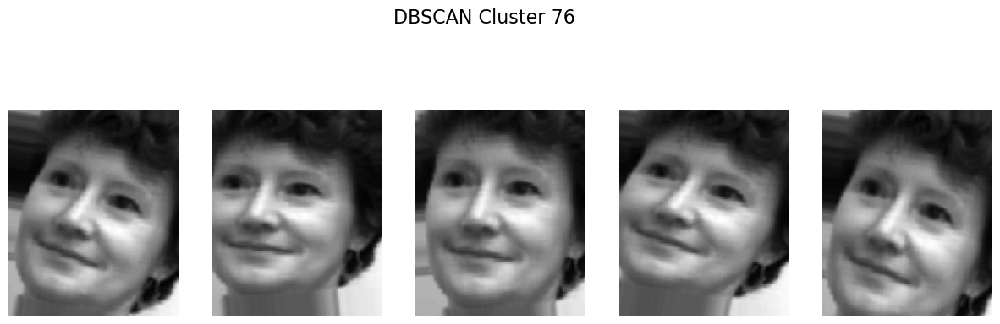

In [21]:
# Function to visualize DBSCAN cluster samples using original images
def plot_dbscan_cluster_images(X_original, dbscan_labels, n_images=5):
    """
    Plot representative original images for each DBSCAN cluster.
    Args:
        X_original (ndarray): Original image data (before PCA).
        dbscan_labels (ndarray): Cluster assignments.
        n_images (int): Number of images to display per cluster.
    """
    unique_clusters = np.unique(dbscan_labels)
    for cluster in unique_clusters:
        if cluster == -1:  # Skip noise points
            continue
        cluster_indices = np.where(dbscan_labels == cluster)[0]
        selected_indices = np.random.choice(cluster_indices, min(len(cluster_indices), n_images), replace=False)

        fig, axes = plt.subplots(1, len(selected_indices), figsize=(15, 5))
        fig.suptitle(f"DBSCAN Cluster {cluster}", fontsize=16)
        
        for i, idx in enumerate(selected_indices):
            img = X_original[idx].reshape(112, 92)  # Reshape back to the original image size
            axes[i].imshow(img, cmap="gray")
            axes[i].axis("off")
        plt.show()

# Plot sample images from DBSCAN clusters
if best_dbscan_model:
    plot_dbscan_cluster_images(X_reshaped, dbscan_labels)
else:
    print("No clusters found by DBSCAN to visualize.")



In [24]:
# Precompute the pairwise distance matrix
distance_matrix = pairwise_distances(latent_representations_pca, metric="euclidean")
distance_matrix = np.maximum(distance_matrix, 0)  # Ensure non-negative values

# Get DBSCAN cluster labels for the full dataset using precomputed distances
dbscan_labels = best_dbscan_model.fit_predict(distance_matrix)

# Map clusters to subjects
def map_clusters_to_subjects(labels, cluster_labels):
    cluster_to_subject = {}
    for cluster in set(cluster_labels):
        if cluster == -1:  # Skip noise
            continue
        # Get subject labels for points in the current cluster
        subject_labels_in_cluster = labels[cluster_labels == cluster]
        # Determine the majority subject in the cluster
        if len(subject_labels_in_cluster) > 0:
            majority_subject = Counter(subject_labels_in_cluster).most_common(1)[0][0]
            cluster_to_subject[cluster] = majority_subject
    return cluster_to_subject

# Map each cluster to a subject based on majority vote
cluster_to_subject_mapping = map_clusters_to_subjects(y, dbscan_labels)

# Print the mapping
print("Cluster to Subject Mapping:")
for cluster, subject in cluster_to_subject_mapping.items():
    print(f"Cluster {cluster}: Subject {subject}")

Cluster to Subject Mapping:
Cluster 0: Subject 0
Cluster 1: Subject 0
Cluster 2: Subject 1
Cluster 3: Subject 1
Cluster 4: Subject 1
Cluster 5: Subject 1
Cluster 6: Subject 2
Cluster 7: Subject 2
Cluster 8: Subject 3
Cluster 9: Subject 3
Cluster 10: Subject 3
Cluster 11: Subject 3
Cluster 12: Subject 3
Cluster 13: Subject 3
Cluster 14: Subject 3
Cluster 15: Subject 4
Cluster 16: Subject 5
Cluster 17: Subject 6
Cluster 18: Subject 6
Cluster 19: Subject 6
Cluster 20: Subject 8
Cluster 21: Subject 9
Cluster 22: Subject 9
Cluster 23: Subject 9
Cluster 24: Subject 10
Cluster 25: Subject 10
Cluster 26: Subject 10
Cluster 27: Subject 11
Cluster 28: Subject 12
Cluster 29: Subject 13
Cluster 30: Subject 13
Cluster 31: Subject 13
Cluster 32: Subject 14
Cluster 33: Subject 14
Cluster 34: Subject 14
Cluster 35: Subject 15
Cluster 36: Subject 15
Cluster 37: Subject 15
Cluster 38: Subject 16
Cluster 39: Subject 16
Cluster 40: Subject 17
Cluster 41: Subject 18
Cluster 42: Subject 19
Cluster 43: Subje


Random Test Images with Real and Predicted Subjects (Including Closest Cluster for Noise):
Image Index: 438, Real Subject: 16, Predicted Cluster: 38, Predicted Subject: 16
Image Index: 85, Real Subject: 2, Predicted Cluster: 7, Predicted Subject: 2
Image Index: 552, Real Subject: 19, Predicted Cluster: 42, Predicted Subject: 19
Image Index: 865, Real Subject: 14, Predicted Cluster: -1 (Noise), Closest Cluster: 36, Predicted Subject: 15
Image Index: 909, Real Subject: 16, Predicted Cluster: -1 (Noise), Closest Cluster: 39, Predicted Subject: 16
Image Index: 452, Real Subject: 17, Predicted Cluster: 40, Predicted Subject: 17
Image Index: 718, Real Subject: 6, Predicted Cluster: -1 (Noise), Closest Cluster: 49, Predicted Subject: 6
Image Index: 418, Real Subject: 15, Predicted Cluster: 36, Predicted Subject: 15
Image Index: 49, Real Subject: 1, Predicted Cluster: 4, Predicted Subject: 1
Image Index: 165, Real Subject: 6, Predicted Cluster: 17, Predicted Subject: 6


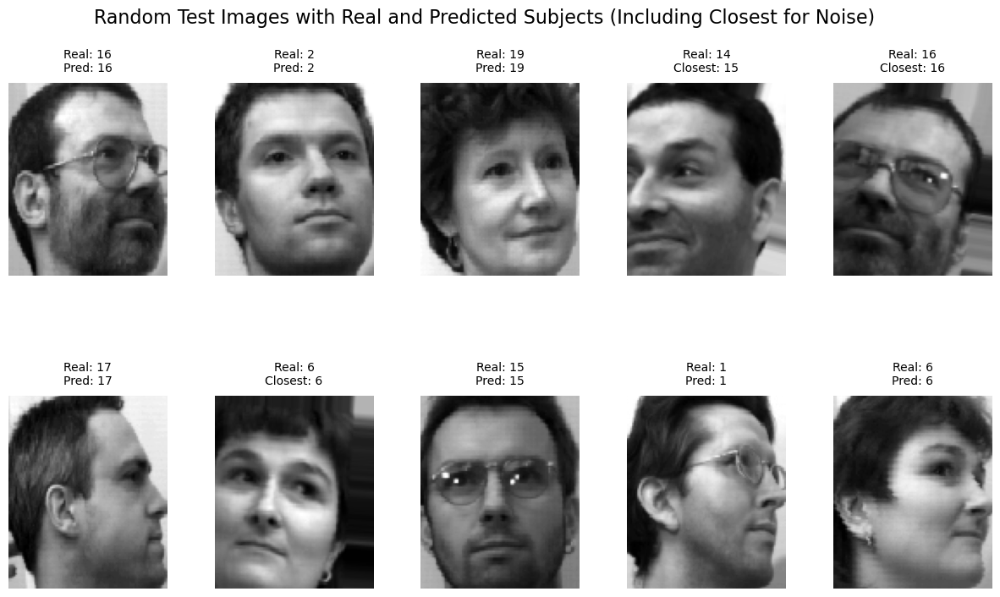

In [23]:


# Select random indices from the dataset
random_indices = np.random.choice(len(latent_representations_pca), size=10, replace=False)
random_images = X[random_indices]  # Assuming X contains the original image data

# Use the precomputed labels from the best DBSCAN model
predicted_clusters = dbscan_labels[random_indices]  # Predict clusters based on precomputed labels

# Predict subject for new random images
print("\nRandom Test Images with Real and Predicted Subjects (Including Closest Cluster for Noise):")
fig, axes = plt.subplots(2, 5, figsize=(15, 8))  # Create subplots for 10 images

for i, (image, cluster) in enumerate(zip(random_images, predicted_clusters)):
    ax = axes[i // 5, i % 5]  # Determine subplot position
    real_subject = y[random_indices[i]]  # Get the real subject number
    if cluster != -1 and cluster in cluster_to_subject_mapping:  # If not noise, map clusters
        predicted_subject = cluster_to_subject_mapping[cluster]
        print(f"Image Index: {random_indices[i]}, Real Subject: {real_subject}, Predicted Cluster: {cluster}, Predicted Subject: {predicted_subject}")
        ax.imshow(image.reshape(112, 92), cmap="gray")  # Display the image
        ax.set_title(f"Real: {real_subject}\nPred: {predicted_subject}", fontsize=10, pad=10)
    else:  # For noise, find the closest cluster
        distances = [
            np.linalg.norm(latent_representations_pca[random_indices[i]] - latent_representations_pca[dbscan_labels == cluster_id].mean(axis=0))
            for cluster_id in cluster_to_subject_mapping.keys()
        ]
        closest_cluster = list(cluster_to_subject_mapping.keys())[np.argmin(distances)]
        predicted_subject = cluster_to_subject_mapping[closest_cluster]
        print(f"Image Index: {random_indices[i]}, Real Subject: {real_subject}, Predicted Cluster: {cluster} (Noise), Closest Cluster: {closest_cluster}, Predicted Subject: {predicted_subject}")
        ax.imshow(image.reshape(112, 92), cmap="gray")  # Display the image
        ax.set_title(f"Real: {real_subject}\nClosest: {predicted_subject}", fontsize=10, pad=10)
    ax.axis("off")  # Remove axis

fig.suptitle("Random Test Images with Real and Predicted Subjects (Including Closest for Noise)", fontsize=16)
plt.subplots_adjust(wspace=0.3, hspace=0.5)  # Add spacing between subplots
plt.show()
